# **Assignment \#4**: Machine Learning MC886/MO444
University of Campinas (UNICAMP), Institute of Computing (IC)

Prof. Marcelo Reis, 2022s1



In [ ]:
# TODO: RA & Name 
print('RA1: 220102 ' + 'André Luiz do Canto Portela')
print('RA2: 183298 ' + 'Marcelo Aparecido Moreira')

RA1: 220102 André Luiz do Canto Portela
RA2: 183298 Marcelo Aparecido Moreira


## Objective 

Explore **clustering techniques** (https://scikit-learn.org/stable/modules/clustering.html) and come up with the best possible model to the problem, avoiding overfitting. In particular, build an clustering model to analisys brazilian music styles [Brazilian Lyrics dataset](https://arxiv.org/pdf/2003.05377.pdf).

# Dataset

Brazilian Lyrics is a dataset build by Romulo Costa and Raul Araujo (PUC-RJ), consisting of 138,368 songs distributed across 14 genres. The authors split the dataset into tree partitions: training (96,857 samples), validation (27,673 samples), and test (13,838 samples).

**Dataset Information:**

- You should respect the following traininig/validation/test split. Avoid overfitting.
- The data is available at: https://drive.google.com/drive/folders/1b681ChByK737CpASYImFB4GfuqPdrvBN
- You should evaluate the models using the Silhouette Coefficient.

## Deadline

Sunday, July 3rd 11:59pm. 

Penalty policy for late submission: You are not encouraged to submit your assignment after due date. However, in case you did, your grade will be penalized as follows:
- July 4th 11:59pm : grade * 0.25


## Submission

On Google Classroom, submit your Jupyter Notebook (in Portuguese or English).

**This activity is NOT individual, it must be done in pairs (two-person group).**

## Activities


**Disclaimer:** Most of the training for the models in this task was run not using Google Colab, but on a separate machine instead (a Gaming Computer i9 10900k with 10 cores, 64 GB of RAM and Geforce RTX3070). All results have been captured and printed already, so there's no need to run all the cells again to visualize them. <br>
[Here](https://drive.google.com/file/d/1bgmszSPv-R-DdB66X_r-NxnCYV3v7PAu/view?usp=sharing) is a google drive which has the saved models, is easier to load them in memory instead of computing again.

Make sure you have required libraries.
**transformers[sentencepiece]** and **torch** are only required to generate the embeddings, so if you already have the embeddings, you don't need them. Just load the embeddings on memory.

In [ ]:
!pip install transformers[sentencepiece] torch --quiet

In [ ]:
!pip install pandas numpy seaborn tqdm ipywidgets ipympl scikit-learn --quiet

### Installation of cuML to perform clustering and dimensionality reduction (optional for compatible GPUs)

Installation steps from a [reference notebook](https://colab.research.google.com/drive/1rY7Ln6rEE1pOlfSHCYOVaqt8OvDO35J0#scrollTo=m0jdXBRiDSzj).

Check for a compatible GPU (Tesla T4, P4, or P100)

In [ ]:
!nvidia-smi

Sat Jul  2 16:32:01 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 515.57       Driver Version: 516.59       CUDA Version: 11.7     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  NVIDIA GeForce ...  On   | 00000000:01:00.0  On |                  N/A |
|  0%   42C    P8    18W / 280W |   1137MiB /  8192MiB |      9%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
!pip install pynvml

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 46 kB 1.7 MB/s 


In [ ]:
# This get the RAPIDS-Colab install files and test check your GPU.  Run this and the next cell only.
# Please read the output of this cell.  If your Colab Instance is not RAPIDS compatible, it will warn you and give you remediation steps.
!git clone https://github.com/rapidsai/rapidsai-csp-utils.git
!python rapidsai-csp-utils/colab/env-check.py

fatal: destination path 'rapidsai-csp-utils' already exists and is not an empty directory.
***********************************************************************
Woo! Your instance has the right kind of GPU, a Tesla T4!
***********************************************************************



In [ ]:
# This will update the Colab environment and restart the kernel.  Don't run the next cell until you see the session crash.
!bash rapidsai-csp-utils/colab/update_gcc.sh
import os
os._exit(00)

Updating your Colab environment.  This will restart your kernel.  Don't Panic!
Hit:1 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu1804/x86_64  InRelease
Get:2 http://security.ubuntu.com/ubuntu bionic-security InRelease [88.7 kB]
Get:3 https://cloud.r-project.org/bin/linux/ubuntu bionic-cran40/ InRelease [3,626 B]
Ign:4 https://developer.download.nvidia.com/compute/machine-learning/repos/ubuntu1804/x86_64  InRelease
Hit:5 https://developer.download.nvidia.com/compute/machine-learning/repos/ubuntu1804/x86_64  Release
Hit:6 http://archive.ubuntu.com/ubuntu bionic InRelease
Get:7 http://ppa.launchpad.net/c2d4u.team/c2d4u4.0+/ubuntu bionic InRelease [15.9 kB]
Get:8 http://archive.ubuntu.com/ubuntu bionic-updates InRelease [88.7 kB]
Get:10 http://archive.ubuntu.com/ubuntu bionic-backports InRelease [74.6 kB]
Get:11 http://security.ubuntu.com/ubuntu bionic-security/multiverse amd64 Packages [22.8 kB]
Get:12 http://security.ubuntu.com/ubuntu bionic-security/restricted amd64 P

In [ ]:
# This will install CondaColab.  This will restart your kernel one last time.  Run this cell by itself and only run the next cell once you see the session crash.
import condacolab
condacolab.install()

⏬ Downloading https://github.com/jaimergp/miniforge/releases/latest/download/Mambaforge-colab-Linux-x86_64.sh...
📦 Installing...
📌 Adjusting configuration...
🩹 Patching environment...
⏲ Done in 0:00:26
🔁 Restarting kernel...


In [ ]:
# you can now run the rest of the cells as normal
import condacolab
condacolab.check()

✨🍰✨ Everything looks OK!


In [ ]:
# Installing RAPIDS is now 'python rapidsai-csp-utils/colab/install_rapids.py <release> <packages>'
# The <release> options are 'stable' and 'nightly'.  Leaving it blank or adding any other words will default to stable.
!python rapidsai-csp-utils/colab/install_rapids.py stable
import os
os.environ['NUMBAPRO_NVVM'] = '/usr/local/cuda/nvvm/lib64/libnvvm.so'
os.environ['NUMBAPRO_LIBDEVICE'] = '/usr/local/cuda/nvvm/libdevice/'
os.environ['CONDA_PREFIX'] = '/usr/local'

Found existing installation: cffi 1.14.5
Uninstalling cffi-1.14.5:
  Successfully uninstalled cffi-1.14.5
Found existing installation: cryptography 3.4.5
Uninstalling cryptography-3.4.5:
  Successfully uninstalled cryptography-3.4.5
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Installing RAPIDS Stable 21.12
Starting the RAPIDS install on Colab.  This will take about 15 minutes.
Solving environment: ...working... WARNING conda.core.solve:_add_specs(611): pinned spec cudatoolkit=11.1 conflicts with explicit specs.  Overriding pinned spec.
failed with initial frozen solve. Retrying with flexible solve.
Solving environment: ...working... WARNING conda.core.solve:_add_specs(611): pinned spec cudatoolkit=11.1 conflicts with explicit specs.  Overriding pinned spec.
failed with repodata from current_repodata.json, will retry with next repodata source.
Solving environment: ...working... WARNING conda.core.solve:_add_specs(611): pinned spec c

If you see the message "*RAPIDS conda installation complete.  Updating Colab's libraries...*", you should be able to use cuml on the GPU.

### Run either dimensionality reduction from sklearn or from cuML.

If cuML library was correctly installed you may perform dimensionality reduction on GPU provided since you have a compatible GPU, otherwise you'll have to use it on the CPU (way slower).

cuML on GPU

In [ ]:
from cuml.decomposition import PCA
from cuml.manifold import TSNE

sklearn on CPU

In [ ]:
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE

### 1. Text Embedding

To generate the embeddings of the songs we used the model (Bertimbau)[https://github.com/neuralmind-ai/portuguese-bert] a model based on BERT for Portuguese.
We embedding the title only, the music only and a combination of title + music.
The embedding vector used is the one referring to the special token [CLS] that generates a compact representation of the input information.

Use one of the available techniques to generate the input text embedding:

* Title embedding
* Music embedding
* Title embedding + music

Analyze the distributions by plotting the embeddings generated with the aid of a dimensionality reduction algorithm.


The main goal of ​​this section is to explore one of the three types of text embeddings available (Title embedding, Music embedding,
Title + music embedding) for the training dataset - *Brazilian Lyrics Dataset* - and then use a dimensionality reduction algorithm so that we can perform scatter plots of the data. In that way, we'll be able to visualize the training dataset through graphs to get an idea of ​​how the datapoints are being grouped.

The device we're going to use in order to get that are the the encoders provided by BERTimbau, which is basically BERT trained for Portuguese, and which uses Transformers as a background. More details can be found [here](https://www.techtarget.com/searchenterpriseai/definition/BERT-language-model) and [here](https://neuralmind.ai/2020/11/29/bertimbau-da-neuralmind-e-recordista-em-downloads). The dimensionality reduction algorithms to be used will be PCA and t-SNE (Scikit Learn documentation for them can be found [here](https://scikit-learn.org/stable/modules/generated/sklearn.decomposition.PCA.html) and [here](https://scikit-learn.org/stable/modules/generated/sklearn.manifold.TSNE.html)).

In [ ]:
# Some library importations

import pickle
import numpy as np
import pandas as pd
from tqdm import tqdm
import multiprocessing as mp
import time

import torch
from transformers import BertTokenizerFast, BertModel

from torch.utils.data import DataLoader
from torch.utils.data import Dataset

model_ckpt = 'neuralmind/bert-base-portuguese-cased'
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

import matplotlib.pyplot as plt
import seaborn as sns
sns.set_theme(style="darkgrid")

from math import sqrt

#### Code used to generate embeddings

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


Choose either to save and load models from a Google Drive folder or from a local folder

Google Drive Folder

In [ ]:
folder = "/content/drive/MyDrive/Colab Notebooks/mo444-machine-learning/t4/"

Local Folder

In [ ]:
folder = "./"

Loading datasets

In [ ]:
df_train = pd.read_csv(folder + "vagalume.train.csv")
print("Training Length dataset: ", df_train.shape)

Training Length dataset:  (96857, 4)


In [ ]:
df_dev = pd.read_csv(folder + "vagalume.dev.csv")
print("Dev Length dataset: ", df_dev.shape)

Dev Length dataset:  (13838, 4)


In [ ]:
df_test = pd.read_csv(folder + "vagalume.test.csv")
print("Test Length dataset: ", df_test.shape)

Test Length dataset:  (27673, 4)


In [ ]:
df_train[df_train['music_lyric'].isnull()]

,artist_name,genre,music_title,music_lyric
1558,Ana Carolina,pop,As Telas E Elas,NaN
3072,Roberto Carlos,jovem-guarda,Eu Sou Terrivel,NaN
3610,Roberto Carlos,jovem-guarda,Susie,NaN
5142,Ana Carolina e Seu Jorge,mpb,Pra Rua Me Levar,NaN
6530,Ana Carolina e Seu Jorge,mpb,Mais Que Isso,NaN
...,...,...,...,...
90609,Djavan,mpb,Luz,NaN
90990,Roberto Carlos,jovem-guarda,Querem Acabar Comigo,NaN
91448,Ana Carolina,pop,Joana,NaN
93351,Ana Carolina,pop,Problemas / Quem de Nós Dois (La Mia Storia Tr...,NaN


In [ ]:
df_train = df_train.dropna()

In [ ]:
df_dev = df_dev.dropna()

In [ ]:
df_test = df_test.dropna()

In [ ]:
df_dev

,artist_name,genre,music_title,music_lyric
0,Adilson Silva,gospel,Carta Para Deus,"A lágrima que cai, desbota tinta no papel\nÉ u..."
1,Harpa Cristã,gospel,Ha Um Amigo Mui Chegado,"Há um amigo mui chegado - Cristo Senhor,\nPois..."
2,Flávio Venturini,mpb,Céu de Santo Amaro,Olho para o céu\nTantas estrelas dizendo da im...
3,André Valadão,gospel,"Cura-me, Senhor",Cura-me Senhor\nCura-me Senhor\nSenhor sara a ...
4,Olodum,axe,Salvador Não Inerte / Ladeira do Pelô,"Olodum, negro elite é negritude\nDeslumbrante ..."
...,...,...,...,...
13833,Pato Fu,rock,No Aeroporto,E o rapaz do raio X do aeroporto\nVê perfeitam...
13834,Nando Reis,mpb,Nosso Amor,"O meu amor, é seu amor\nTambém por ele\nO meu ..."
13835,Pedro Bento e Zé da Estrada,sertanejo,De Gole Em Gole,eu vou de gole em gole tomando porre por causa...
13836,Ozeias de Paula,gospel,É Assim Que Eu Te Amo,eu te amo mais que a abelha ama a flor\neu te ...


In [ ]:
len(df_dev['music_lyric'].unique())

13798

In [ ]:
len(df_dev['artist_name'].unique())

2160

In [ ]:
len(df_dev['genre'].unique())

14

In [ ]:
class MusicaDataset(Dataset):

    def __init__(self, data, embedding_type):
        """
        You can try some variations of the text that will be
        used. Ex: Title + Music, Music, Title
        """
        if embedding_type == "title":
          self.texts = data['music_title'].values
        elif embedding_type == "lyrics":
          self.texts = data['music_lyric'].values
        elif embedding_type == "title+lyrics":
          self.texts = (data['music_title'] + " " + data['music_lyric']).values
        else:
          raise Exception(f"Wrong type: {embedding_type}")

    def __len__(self):
        return len(self.texts)
    
    def __getitem__(self, idx):

        text = self.texts[idx]

        return text

In [ ]:
dataset_train_title = MusicaDataset(df_train, "title")
dataset_train_lyrics = MusicaDataset(df_train, "lyrics")
dataset_train_title_lyrics = MusicaDataset(df_train, "title+lyrics")

In [ ]:
dataset_dev_title = MusicaDataset(df_dev, "title")
dataset_dev_lyrics = MusicaDataset(df_dev, "lyrics")
dataset_dev_title_lyrics = MusicaDataset(df_dev, "title+lyrics")

In [ ]:
dataset_test_title_lyrics = MusicaDataset(df_test, "title+lyrics")

In [ ]:
def collate_fn(batch):
    """
    Input all text samples
    """    

    texts = [r[0].replace('\n', ' ') for r in batch]
    
    batch_tokens = tokenizer.batch_encode_plus(texts,
                                    padding='max_length', 
                                    truncation=True, 
                                    max_length=256,
                                    return_tensors="pt")
        
    return (
        batch_tokens["input_ids"],
)

In [ ]:
dataloader_train_title_shuffle_false = DataLoader(
                            dataset_train_title,
                            batch_size=256,
                            num_workers=mp.cpu_count(),
                            shuffle=False,
                            collate_fn=collate_fn
                          )
dataloader_train_lyrics_shuffle_false = DataLoader(
                            dataset_train_lyrics,
                            batch_size=256,
                            num_workers=mp.cpu_count(),
                            shuffle=False,
                            collate_fn=collate_fn
                          )
dataloader_train_title_lyrics_shuffle_false = DataLoader(
                            dataset_train_title_lyrics,
                            batch_size=256,
                            num_workers=mp.cpu_count(),
                            shuffle=False,
                            collate_fn=collate_fn
                          )
dataloader_dev_title_shuffle_false = DataLoader(
                            dataset_dev_title,
                            batch_size=256,
                            num_workers=mp.cpu_count(),
                            shuffle=False,
                            collate_fn=collate_fn
                          )
dataloader_dev_lyrics_shuffle_false = DataLoader(
                            dataset_dev_lyrics,
                            batch_size=256,
                            num_workers=mp.cpu_count(),
                            shuffle=False,
                            collate_fn=collate_fn
                          )
dataloader_dev_title_lyrics_shuffle_false = DataLoader(
                            dataset_dev_title_lyrics,
                            batch_size=256,
                            num_workers=mp.cpu_count(),
                            shuffle=False,
                            collate_fn=collate_fn
                          )

In [ ]:
dataloader_test_title_lyrics_shuffle_false = DataLoader(
                            dataset_test_title_lyrics,
                            batch_size=256,
                            num_workers=mp.cpu_count(),
                            shuffle=False,
                            collate_fn=collate_fn
                          )

In [ ]:
tokenizer = BertTokenizerFast.from_pretrained(model_ckpt) 
model = BertModel.from_pretrained(model_ckpt)

Downloading:   0%|          | 0.00/43.0 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/205k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/2.00 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/112 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/647 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/418M [00:00<?, ?B/s]

Some weights of the model checkpoint at neuralmind/bert-base-portuguese-cased were not used when initializing BertModel: ['cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.transform.dense.bias', 'cls.predictions.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.weight', 'cls.predictions.transform.dense.weight', 'cls.predictions.transform.LayerNorm.weight']
- This IS expected if you are initializing BertModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing BertModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


In [ ]:
def generate_embeddings(model, dataloader):
    model.eval()
    model.to(device)
    embeddings_bert = None
    for batch in tqdm(dataloader):
        inputs = batch[0].to(device)
        with torch.no_grad():
            out_data = model(inputs)
            if embeddings_bert is None:
                embeddings_bert = out_data['pooler_output'].cpu().numpy()
            else:
                embeddings_bert = np.concatenate((embeddings_bert, out_data['pooler_output'].cpu().numpy()), axis=0)
    return embeddings_bert

### Generating embeddings without shuffle

training embeddings

In [ ]:
embeddings_train_title_shuffle_false = generate_embeddings(model, dataloader_train_title_shuffle_false)
np.save(folder + 'embedding_train_title_shuffle_false.npy', embeddings_train_title_shuffle_false)

In [ ]:
embeddings_train_lyrics_shuffle_false = generate_embeddings(model, dataloader_train_lyrics_shuffle_false)
np.save(folder + 'embedding_train_lyrics_shuffle_false.npy', embeddings_train_lyrics_shuffle_false)

100%|██████████| 379/379 [25:30<00:00,  4.04s/it]


In [ ]:
embeddings_train_title_lyrics_shuffle_false = generate_embeddings(model, dataloader_train_title_lyrics_shuffle_false)
np.save(folder + 'embedding_train_title_lyrics_shuffle_false.npy', embeddings_train_title_lyrics_shuffle_false)

100%|██████████| 379/379 [25:31<00:00,  4.04s/it]


dev embeddings

In [ ]:
embeddings_dev_title_shuffle_false = generate_embeddings(model, dataloader_dev_title_shuffle_false)
np.save(folder + 'embedding_dev_title_shuffle_false.npy', embeddings_dev_title_shuffle_false)

100%|██████████| 54/54 [03:18<00:00,  3.68s/it]


In [ ]:
embeddings_dev_lyrics_shuffle_false = generate_embeddings(model, dataloader_dev_lyrics_shuffle_false)
np.save(folder + 'embedding_dev_lyrics_shuffle_false.npy', embeddings_dev_lyrics_shuffle_false)

100%|██████████| 54/54 [03:31<00:00,  3.93s/it]


In [ ]:
embeddings_dev_title_lyrics_shuffle_false = generate_embeddings(model, dataloader_dev_title_lyrics_shuffle_false)
np.save(folder + 'embedding_dev_title_lyrics_shuffle_false.npy', embeddings_dev_title_lyrics_shuffle_false)

100%|██████████| 54/54 [03:34<00:00,  3.97s/it]


test embedding

In [ ]:
embeddings_test_title_lyrics_shuffle_false = generate_embeddings(model, dataloader_test_title_lyrics_shuffle_false)
np.save(folder + 'embedding_test_title_lyrics_shuffle_false.npy', embeddings_test_title_lyrics_shuffle_false)

100%|██████████| 109/109 [06:21<00:00,  3.50s/it]


### Loading corresponding embeddings

#### Loading embeddings without shuffling

training embeddings

In [ ]:
embeddings_train_title_shuffle_false = np.load(folder + 'embedding_train_title_shuffle_false.npy')

In [ ]:
embeddings_train_lyrics_shuffle_false = np.load(folder + 'embedding_train_lyrics_shuffle_false.npy')

In [ ]:
embeddings_train_title_lyrics_shuffle_false = np.load(folder + 'embedding_train_title_lyrics_shuffle_false.npy')

dev embeddings

In [ ]:
embeddings_dev_title_shuffle_false = np.load(folder + 'embedding_dev_title_shuffle_false.npy')

In [ ]:
embeddings_dev_lyrics_shuffle_false = np.load(folder + 'embedding_dev_lyrics_shuffle_false.npy')

In [ ]:
embeddings_dev_title_lyrics_shuffle_false = np.load(folder + 'embedding_dev_title_lyrics_shuffle_false.npy')

test embedding

In [ ]:
embeddings_test_title_lyrics_shuffle_false = np.load(folder + 'embedding_test_title_lyrics_shuffle_false.npy')

In [ ]:
(
    embeddings_train_title_shuffle_false.shape, "embeddings_train_title_shuffle_false",
    embeddings_train_lyrics_shuffle_false.shape, "embeddings_train_lyrics_shuffle_false",
    embeddings_train_title_lyrics_shuffle_false.shape, "embeddings_train_title_lyrics_shuffle_false",
    embeddings_dev_title_shuffle_false.shape, "embeddings_dev_title_shuffle_false",
    embeddings_dev_lyrics_shuffle_false.shape, "embeddings_dev_lyrics_shuffle_false",
    embeddings_dev_title_lyrics_shuffle_false.shape, "embeddings_dev_title_lyrics_shuffle_false",
    embeddings_test_title_lyrics_shuffle_false.shape, "embeddings_test_title_lyrics_shuffle_false",
)

((96783, 768),
 'embeddings_train_title_shuffle_false',
 (96783, 768),
 'embeddings_train_lyrics_shuffle_false',
 (96783, 768),
 'embeddings_train_title_lyrics_shuffle_false',
 (13824, 768),
 'embeddings_dev_title_shuffle_false',
 (13824, 768),
 'embeddings_dev_lyrics_shuffle_false',
 (13824, 768),
 'embeddings_dev_title_lyrics_shuffle_false',
 (27654, 768),
 'embeddings_test_title_lyrics_shuffle_false')

### Performing dimensionality reduction

#### Using PCA

In [ ]:
pca_dev_title_lyrics_shuffle_false = PCA(n_components=2, random_state=0)
pca_dev_title_lyrics_shuffle_false.fit(embeddings_dev_title_lyrics_shuffle_false)

PCA(n_components=2, random_state=0)

In [ ]:
embeddings_dev_title_lyrics_pca_shuffle_false = pca_dev_title_lyrics_shuffle_false.transform(embeddings_dev_title_lyrics_shuffle_false)
embeddings_dev_title_lyrics_pca_shuffle_false.shape

(13824, 2)

In [ ]:
pca_train_title_lyrics_shuffle_false = PCA(n_components=2, random_state=0)
pca_train_title_lyrics_shuffle_false.fit(embeddings_train_title_lyrics_shuffle_false)

PCA(n_components=2, random_state=0)

In [ ]:
embeddings_train_title_lyrics_pca_shuffle_false = pca_train_title_lyrics_shuffle_false.transform(embeddings_train_title_lyrics_shuffle_false)
embeddings_train_title_lyrics_pca_shuffle_false.shape

(96783, 2)

Using PCA to reduce 768 features to just two components in this case loses too much of the original variance

In [ ]:
sum(pca_train_title_lyrics_shuffle_false.explained_variance_ratio_), pca_train_title_lyrics_shuffle_false.explained_variance_ratio_

(0.5844172093100498, array([0.46984005, 0.11457716]))

In [ ]:
pca_train_title_shuffle_false = PCA(n_components=2, random_state=0)
pca_train_title_shuffle_false.fit(embeddings_train_title_shuffle_false)

PCA(n_components=2, random_state=0)

In [ ]:
embeddings_train_title_pca_shuffle_false = pca_train_title_shuffle_false.transform(embeddings_train_title_shuffle_false)
embeddings_train_title_pca_shuffle_false.shape

(96783, 2)

In [ ]:
pca_train_lyrics_shuffle_false = PCA(n_components=2, random_state=0)
pca_train_lyrics_shuffle_false.fit(embeddings_train_lyrics_shuffle_false)

PCA(n_components=2, random_state=0)

In [ ]:
embeddings_train_lyrics_pca_shuffle_false = pca_train_lyrics_shuffle_false.transform(embeddings_train_lyrics_shuffle_false)
embeddings_train_lyrics_pca_shuffle_false.shape

(96783, 2)

In [ ]:
pca_train_title_lyrics_shuffle_false15 = PCA(n_components=15, random_state=0)
pca_train_title_lyrics_shuffle_false15.fit(embeddings_train_title_lyrics_shuffle_false)

PCA(n_components=15, random_state=0)

In [ ]:
embeddings_train_title_lyrics_pca_shuffle_false15 = pca_train_title_lyrics_shuffle_false15.transform(embeddings_train_title_lyrics_shuffle_false)
embeddings_train_title_lyrics_pca_shuffle_false15.shape

(96783, 15)

Using PCA to reduce 768 features to 15 components in this case retains most the original variance >96%

In [ ]:
sum(pca_train_title_lyrics_shuffle_false15.explained_variance_ratio_), pca_train_title_lyrics_shuffle_false15.explained_variance_ratio_

(0.96353382015647,
 array([0.46984019, 0.11457715, 0.08049847, 0.05861871, 0.04524966,
        0.03992204, 0.0336617 , 0.02849243, 0.02643845, 0.01758376,
        0.01237368, 0.01098564, 0.00907842, 0.00831669, 0.00789686]))

It is necessary to double the number of components to 30 to retain >90% of the original variance

In [ ]:
pca_train_title_lyrics_shuffle_false30 = PCA(n_components=30, random_state=0)
pca_train_title_lyrics_shuffle_false30.fit(embeddings_train_title_lyrics_shuffle_false)
embeddings_train_title_lyrics_pca_shuffle_false30 = pca_train_title_lyrics_shuffle_false30.transform(embeddings_train_title_lyrics_shuffle_false)
print(embeddings_train_title_lyrics_pca_shuffle_false30.shape)
print(sum(pca_train_title_lyrics_shuffle_false30.explained_variance_ratio_), pca_train_title_lyrics_shuffle_false30.explained_variance_ratio_)

(96783, 30)
0.9986206306656361 [4.69840046e-01 1.14577225e-01 8.04984512e-02 5.86187335e-02
 4.52496667e-02 3.99220544e-02 3.36616824e-02 2.84924271e-02
 2.64384455e-02 1.75837645e-02 1.23736746e-02 1.09856269e-02
 9.07840020e-03 8.31668769e-03 7.89685020e-03 6.54100080e-03
 5.97563875e-03 4.72061706e-03 4.65720145e-03 3.46398891e-03
 2.74331760e-03 1.81332904e-03 1.25798134e-03 1.04546621e-03
 7.00583680e-04 6.37387011e-04 4.88413970e-04 4.19004626e-04
 3.47667382e-04 2.75296685e-04]


#### Function to compute T-SNE

In [ ]:
def compute_tsne(embedding, n_components, perplexity, learning_rate=50.0, verbose=1):
  print (f"TSNE started: ", time.strftime("%H:%M:%S"))
  start = time.time()

  tsne_embedding = TSNE(
      n_components=n_components, 
      perplexity=perplexity,
      method='barnes_hut',
      learning_rate=learning_rate, 
      init='random', 
      random_state=0, 
      n_jobs=-1, # parallelize in all cpus
      verbose=verbose,
  )
  tsne_embedding.fit(embedding)

  end = time.time()
  print(f"seconds {end - start}")
  print (f"TSNE ended: ", time.strftime("%H:%M:%S"))
  return tsne_embedding

In [ ]:
pca_dev_lyrics_shuffle_false30 = PCA(n_components=30)
pca_dev_lyrics_shuffle_false30.fit(embeddings_dev_lyrics_shuffle_false)

PCA(n_components=30)

In [ ]:
embeddings_pca_dev_lyrics_shuffle_false30 = pca_dev_lyrics_shuffle_false30.transform(embeddings_dev_lyrics_shuffle_false)
embeddings_pca_dev_lyrics_shuffle_false30.shape

(13824, 30)

In [ ]:
sum(pca_dev_lyrics_shuffle_false30.explained_variance_ratio_), pca_dev_lyrics_shuffle_false30.explained_variance_ratio_

(0.9956886710133404,
 array([0.42799175, 0.12661628, 0.08563471, 0.05448779, 0.05341956,
        0.04188835, 0.03494132, 0.03085325, 0.02315649, 0.01801892,
        0.01421809, 0.01216144, 0.01109275, 0.00900547, 0.00761762,
        0.00709047, 0.00596601, 0.00548094, 0.00472481, 0.00430185,
        0.00320189, 0.00286208, 0.00265748, 0.00195059, 0.00163518,
        0.00149887, 0.00105474, 0.00092813, 0.00073889, 0.00049296],
       dtype=float32))

In [ ]:
tsne_embeddings_dev_lyrics_shuffle_false = compute_tsne(
    embedding=embeddings_pca_dev_lyrics_shuffle_false30, 
    n_components=2, 
    perplexity=50
)
print(f"kl_divergence {tsne_embeddings_dev_lyrics_shuffle_false.kl_divergence_}")

[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 13824 samples in 0.000s...
[t-SNE] Computed neighbors for 13824 samples in 3.518s...
[t-SNE] Computed conditional probabilities for sample 1000 / 13824
[t-SNE] Computed conditional probabilities for sample 2000 / 13824
[t-SNE] Computed conditional probabilities for sample 3000 / 13824
[t-SNE] Computed conditional probabilities for sample 4000 / 13824
[t-SNE] Computed conditional probabilities for sample 5000 / 13824
[t-SNE] Computed conditional probabilities for sample 6000 / 13824
[t-SNE] Computed conditional probabilities for sample 7000 / 13824
[t-SNE] Computed conditional probabilities for sample 8000 / 13824
[t-SNE] Computed conditional probabilities for sample 9000 / 13824
[t-SNE] Computed conditional probabilities for sample 10000 / 13824
[t-SNE] Computed conditional probabilities for sample 11000 / 13824
[t-SNE] Computed conditional probabilities for sample 12000 / 13824
[t-SNE] Computed conditional probabilities for sa

In [ ]:
pca_train_lyrics_shuffle_false2 = PCA(n_components=2)
pca_train_lyrics_shuffle_false2.fit(embeddings_train_lyrics_shuffle_false)
embeddings_pca_train_lyrics_shuffle_false2 = pca_train_lyrics_shuffle_false2.transform(embeddings_train_lyrics_shuffle_false)
print('shape', embeddings_pca_train_lyrics_shuffle_false2.shape)
print(sum(pca_train_lyrics_shuffle_false2.explained_variance_ratio_), pca_train_lyrics_shuffle_false2.explained_variance_ratio_)

shape (96783, 2)
0.5534639393855411 [0.42492614 0.1285378 ]


In [ ]:
%%time
tsne_embeddings_pca_train_lyrics_shuffle_false2 = compute_tsne(
    embedding=embeddings_pca_train_lyrics_shuffle_false2, 
    n_components=2, 
    perplexity=50
)
print(f"kl_divergence {tsne_embeddings_pca_train_lyrics_shuffle_false2.kl_divergence_}")

[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 96783 samples in 0.024s...
[t-SNE] Computed neighbors for 96783 samples in 8.114s...
[t-SNE] Computed conditional probabilities for sample 1000 / 96783
[t-SNE] Computed conditional probabilities for sample 2000 / 96783
[t-SNE] Computed conditional probabilities for sample 3000 / 96783
[t-SNE] Computed conditional probabilities for sample 4000 / 96783
[t-SNE] Computed conditional probabilities for sample 5000 / 96783
[t-SNE] Computed conditional probabilities for sample 6000 / 96783
[t-SNE] Computed conditional probabilities for sample 7000 / 96783
[t-SNE] Computed conditional probabilities for sample 8000 / 96783
[t-SNE] Computed conditional probabilities for sample 9000 / 96783
[t-SNE] Computed conditional probabilities for sample 10000 / 96783
[t-SNE] Computed conditional probabilities for sample 11000 / 96783
[t-SNE] Computed conditional probabilities for sample 12000 / 96783
[t-SNE] Computed conditional probabilities for sa

#### Function to save and load T-SNE embeddings and avoid computing again

In [ ]:
def save_tsne_embeddings(tsne_embedding, file_name):
    print(f"saving: {file_name}")
    filehandler = open(folder + file_name,"wb")
    pickle.dump(tsne_embedding,filehandler)
    filehandler.close()
    print(f"saved: {file_name}")

def load_tsne_embeddings(file_name):
    print(f"loading: {file_name}")
    file = open(folder + file_name,'rb')
    loaded_embedding = pickle.load(file)
    file.close()
    print(f"loaded: {file_name}")
    return loaded_embedding

In [ ]:
tsne_file_model_training_pca_2 = "tsne_embeddings_pca_train_lyrics_shuffle_false2.pickle"

In [ ]:
save_tsne_embeddings(tsne_embeddings_pca_train_lyrics_shuffle_false2, tsne_file_model_training_pca_2)

In [ ]:
tsne_embeddings_pca_train_lyrics_shuffle_false2_loaded = load_tsne_embeddings(tsne_file_model_training_pca_2)

In [ ]:
tsne_embeddings_pca_train_lyrics_shuffle_false2_loaded.embedding_.shape

(96783, 2)

Comparing saved array and loaded array to make sure they are equal

In [ ]:
np.array_equal(tsne_embeddings_pca_train_lyrics_shuffle_false2.embedding_, tsne_embeddings_pca_train_lyrics_shuffle_false2_loaded.embedding_)

True

#### Experimenting with several t-sne computations

In [ ]:
tsne_embeddings_dev_title_shuffle_false = compute_tsne(
    embedding=embeddings_dev_title_shuffle_false, 
    n_components=2, 
    perplexity=50
)

[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 13824 samples in 0.005s...
[t-SNE] Computed neighbors for 13824 samples in 6.086s...
[t-SNE] Computed conditional probabilities for sample 1000 / 13824
[t-SNE] Computed conditional probabilities for sample 2000 / 13824
[t-SNE] Computed conditional probabilities for sample 3000 / 13824
[t-SNE] Computed conditional probabilities for sample 4000 / 13824
[t-SNE] Computed conditional probabilities for sample 5000 / 13824
[t-SNE] Computed conditional probabilities for sample 6000 / 13824
[t-SNE] Computed conditional probabilities for sample 7000 / 13824
[t-SNE] Computed conditional probabilities for sample 8000 / 13824
[t-SNE] Computed conditional probabilities for sample 9000 / 13824
[t-SNE] Computed conditional probabilities for sample 10000 / 13824
[t-SNE] Computed conditional probabilities for sample 11000 / 13824
[t-SNE] Computed conditional probabilities for sample 12000 / 13824
[t-SNE] Computed conditional probabilities for sa

In [ ]:
save_tsne_embeddings(tsne_embeddings_dev_title_shuffle_false, "tsne_embeddings_dev_title_shuffle_false.pickle")

saving: tsne_embeddings_dev_title_shuffle_false.pickle
saved: tsne_embeddings_dev_title_shuffle_false.pickle


In [ ]:
tsne_embeddings_dev_title_lyrics_shuffle_false = compute_tsne(
    embedding=embeddings_dev_title_lyrics_shuffle_false, 
    n_components=2, 
    perplexity=100
)

TSNE started:  18:14:54
[t-SNE] Computing 301 nearest neighbors...
[t-SNE] Indexed 13824 samples in 0.006s...
[t-SNE] Computed neighbors for 13824 samples in 6.265s...
[t-SNE] Computed conditional probabilities for sample 1000 / 13824
[t-SNE] Computed conditional probabilities for sample 2000 / 13824
[t-SNE] Computed conditional probabilities for sample 3000 / 13824
[t-SNE] Computed conditional probabilities for sample 4000 / 13824
[t-SNE] Computed conditional probabilities for sample 5000 / 13824
[t-SNE] Computed conditional probabilities for sample 6000 / 13824
[t-SNE] Computed conditional probabilities for sample 7000 / 13824
[t-SNE] Computed conditional probabilities for sample 8000 / 13824
[t-SNE] Computed conditional probabilities for sample 9000 / 13824
[t-SNE] Computed conditional probabilities for sample 10000 / 13824
[t-SNE] Computed conditional probabilities for sample 11000 / 13824
[t-SNE] Computed conditional probabilities for sample 12000 / 13824
[t-SNE] Computed conditio

In [ ]:
save_tsne_embeddings(tsne_embeddings_dev_title_lyrics_shuffle_false, "tsne_embeddings_dev_title_lyrics_shuffle_false.pickle")

saving: tsne_embeddings_dev_title_lyrics_shuffle_false.pickle
saved: tsne_embeddings_dev_title_lyrics_shuffle_false.pickle


In [ ]:
embeddings_train_lyrics_shuffle_false.shape

(96783, 768)

In [ ]:
tsne_embeddings_train_lyrics_full_shuffle_false = compute_tsne(
    embedding=embeddings_train_lyrics_shuffle_false, 
    n_components=2, 
    perplexity=100
)

TSNE started:  18:18:40
[t-SNE] Computing 301 nearest neighbors...
[t-SNE] Indexed 96783 samples in 0.037s...
[t-SNE] Computed neighbors for 96783 samples in 390.983s...
[t-SNE] Computed conditional probabilities for sample 1000 / 96783
[t-SNE] Computed conditional probabilities for sample 2000 / 96783
[t-SNE] Computed conditional probabilities for sample 3000 / 96783
[t-SNE] Computed conditional probabilities for sample 4000 / 96783
[t-SNE] Computed conditional probabilities for sample 5000 / 96783
[t-SNE] Computed conditional probabilities for sample 6000 / 96783
[t-SNE] Computed conditional probabilities for sample 7000 / 96783
[t-SNE] Computed conditional probabilities for sample 8000 / 96783
[t-SNE] Computed conditional probabilities for sample 9000 / 96783
[t-SNE] Computed conditional probabilities for sample 10000 / 96783
[t-SNE] Computed conditional probabilities for sample 11000 / 96783
[t-SNE] Computed conditional probabilities for sample 12000 / 96783
[t-SNE] Computed condit

In [ ]:
save_tsne_embeddings(tsne_embeddings_train_lyrics_full_shuffle_false, "tsne_embeddings_train_lyrics_full_shuffle_false.pickle")

saving: tsne_embeddings_train_lyrics_full_shuffle_false.pickle
saved: tsne_embeddings_train_lyrics_full_shuffle_false.pickle


In [ ]:
tsne_embeddings_train_lyrics_shuffle_false_perplexity50 = compute_tsne(
    embedding=embeddings_train_lyrics_shuffle_false, 
    n_components=2, 
    perplexity=50
)

TSNE started:  19:03:45
[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 96783 samples in 0.037s...
[t-SNE] Computed neighbors for 96783 samples in 366.916s...
[t-SNE] Computed conditional probabilities for sample 1000 / 96783
[t-SNE] Computed conditional probabilities for sample 2000 / 96783
[t-SNE] Computed conditional probabilities for sample 3000 / 96783
[t-SNE] Computed conditional probabilities for sample 4000 / 96783
[t-SNE] Computed conditional probabilities for sample 5000 / 96783
[t-SNE] Computed conditional probabilities for sample 6000 / 96783
[t-SNE] Computed conditional probabilities for sample 7000 / 96783
[t-SNE] Computed conditional probabilities for sample 8000 / 96783
[t-SNE] Computed conditional probabilities for sample 9000 / 96783
[t-SNE] Computed conditional probabilities for sample 10000 / 96783
[t-SNE] Computed conditional probabilities for sample 11000 / 96783
[t-SNE] Computed conditional probabilities for sample 12000 / 96783
[t-SNE] Computed condit

In [ ]:
save_tsne_embeddings(tsne_embeddings_train_lyrics_shuffle_false_perplexity50, "tsne_embeddings_train_lyrics_shuffle_false_perplexity50.pickle")

saving: tsne_embeddings_train_lyrics_shuffle_false_perplexity50.pickle
saved: tsne_embeddings_train_lyrics_shuffle_false_perplexity50.pickle


In [ ]:
tsne_embeddings_train_lyrics_shuffle_false_perplexity10 = compute_tsne(
    embedding=embeddings_train_lyrics_shuffle_false, 
    n_components=2, 
    perplexity=10
)

TSNE started:  20:49:58
[t-SNE] Computing 31 nearest neighbors...
[t-SNE] Indexed 96783 samples in 0.037s...
[t-SNE] Computed neighbors for 96783 samples in 335.307s...
[t-SNE] Computed conditional probabilities for sample 1000 / 96783
[t-SNE] Computed conditional probabilities for sample 2000 / 96783
[t-SNE] Computed conditional probabilities for sample 3000 / 96783
[t-SNE] Computed conditional probabilities for sample 4000 / 96783
[t-SNE] Computed conditional probabilities for sample 5000 / 96783
[t-SNE] Computed conditional probabilities for sample 6000 / 96783
[t-SNE] Computed conditional probabilities for sample 7000 / 96783
[t-SNE] Computed conditional probabilities for sample 8000 / 96783
[t-SNE] Computed conditional probabilities for sample 9000 / 96783
[t-SNE] Computed conditional probabilities for sample 10000 / 96783
[t-SNE] Computed conditional probabilities for sample 11000 / 96783
[t-SNE] Computed conditional probabilities for sample 12000 / 96783
[t-SNE] Computed conditi

In [ ]:
save_tsne_embeddings(tsne_embeddings_train_lyrics_shuffle_false_perplexity10, "tsne_embeddings_train_lyrics_shuffle_false_perplexity10.pickle")

saving: tsne_embeddings_train_lyrics_shuffle_false_perplexity10.pickle
saved: tsne_embeddings_train_lyrics_shuffle_false_perplexity10.pickle


In [ ]:
tsne_embeddings_train_lyrics_shuffle_false_perplexity20 = compute_tsne(
    embedding=embeddings_train_lyrics_shuffle_false, 
    n_components=2, 
    perplexity=20
)

TSNE started:  21:00:51
[t-SNE] Computing 61 nearest neighbors...
[t-SNE] Indexed 96783 samples in 0.036s...
[t-SNE] Computed neighbors for 96783 samples in 341.361s...
[t-SNE] Computed conditional probabilities for sample 1000 / 96783
[t-SNE] Computed conditional probabilities for sample 2000 / 96783
[t-SNE] Computed conditional probabilities for sample 3000 / 96783
[t-SNE] Computed conditional probabilities for sample 4000 / 96783
[t-SNE] Computed conditional probabilities for sample 5000 / 96783
[t-SNE] Computed conditional probabilities for sample 6000 / 96783
[t-SNE] Computed conditional probabilities for sample 7000 / 96783
[t-SNE] Computed conditional probabilities for sample 8000 / 96783
[t-SNE] Computed conditional probabilities for sample 9000 / 96783
[t-SNE] Computed conditional probabilities for sample 10000 / 96783
[t-SNE] Computed conditional probabilities for sample 11000 / 96783
[t-SNE] Computed conditional probabilities for sample 12000 / 96783
[t-SNE] Computed conditi

In [ ]:
save_tsne_embeddings(tsne_embeddings_train_lyrics_shuffle_false_perplexity20, "tsne_embeddings_train_lyrics_shuffle_false_perplexity10.pickle")

saving: tsne_embeddings_train_lyrics_shuffle_false_perplexity10.pickle
saved: tsne_embeddings_train_lyrics_shuffle_false_perplexity10.pickle


In [ ]:
embeddings_train_title_shuffle_false.shape

(96783, 768)

In [ ]:
tsne_embeddings_train_title_shuffle_false_perplexity20 = compute_tsne(
    embedding=embeddings_train_title_shuffle_false, 
    n_components=2, 
    perplexity=20
)

TSNE started:  21:54:15
[t-SNE] Computing 61 nearest neighbors...
[t-SNE] Indexed 96783 samples in 0.037s...
[t-SNE] Computed neighbors for 96783 samples in 365.241s...
[t-SNE] Computed conditional probabilities for sample 1000 / 96783
[t-SNE] Computed conditional probabilities for sample 2000 / 96783
[t-SNE] Computed conditional probabilities for sample 3000 / 96783
[t-SNE] Computed conditional probabilities for sample 4000 / 96783
[t-SNE] Computed conditional probabilities for sample 5000 / 96783
[t-SNE] Computed conditional probabilities for sample 6000 / 96783
[t-SNE] Computed conditional probabilities for sample 7000 / 96783
[t-SNE] Computed conditional probabilities for sample 8000 / 96783
[t-SNE] Computed conditional probabilities for sample 9000 / 96783
[t-SNE] Computed conditional probabilities for sample 10000 / 96783
[t-SNE] Computed conditional probabilities for sample 11000 / 96783
[t-SNE] Computed conditional probabilities for sample 12000 / 96783
[t-SNE] Computed conditi

In [ ]:
save_tsne_embeddings(tsne_embeddings_train_title_shuffle_false_perplexity20, "tsne_embeddings_train_title_shuffle_false_perplexity20.pickle")

saving: tsne_embeddings_train_title_shuffle_false_perplexity20.pickle
saved: tsne_embeddings_train_title_shuffle_false_perplexity20.pickle


In [ ]:
tsne_embeddings_train_title_shuffle_false_perplexity50 = compute_tsne(
    embedding=embeddings_train_title_shuffle_false, 
    n_components=2, 
    perplexity=50
)

TSNE started:  22:25:23
[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 96783 samples in 0.035s...
[t-SNE] Computed neighbors for 96783 samples in 352.881s...
[t-SNE] Computed conditional probabilities for sample 1000 / 96783
[t-SNE] Computed conditional probabilities for sample 2000 / 96783
[t-SNE] Computed conditional probabilities for sample 3000 / 96783
[t-SNE] Computed conditional probabilities for sample 4000 / 96783
[t-SNE] Computed conditional probabilities for sample 5000 / 96783
[t-SNE] Computed conditional probabilities for sample 6000 / 96783
[t-SNE] Computed conditional probabilities for sample 7000 / 96783
[t-SNE] Computed conditional probabilities for sample 8000 / 96783
[t-SNE] Computed conditional probabilities for sample 9000 / 96783
[t-SNE] Computed conditional probabilities for sample 10000 / 96783
[t-SNE] Computed conditional probabilities for sample 11000 / 96783
[t-SNE] Computed conditional probabilities for sample 12000 / 96783
[t-SNE] Computed condit

In [ ]:
save_tsne_embeddings(tsne_embeddings_train_title_shuffle_false_perplexity50, "tsne_embeddings_train_title_shuffle_false_perplexity20.pickle")

saving: tsne_embeddings_train_title_shuffle_false_perplexity20.pickle
saved: tsne_embeddings_train_title_shuffle_false_perplexity20.pickle


In [ ]:
tsne_embeddings_train_title_shuffle_false_perplexity100 = compute_tsne(
    embedding=embeddings_train_title_shuffle_false, 
    n_components=2, 
    perplexity=100
)

TSNE started:  22:39:08
[t-SNE] Computing 301 nearest neighbors...
[t-SNE] Indexed 96783 samples in 0.034s...
[t-SNE] Computed neighbors for 96783 samples in 353.840s...
[t-SNE] Computed conditional probabilities for sample 1000 / 96783
[t-SNE] Computed conditional probabilities for sample 2000 / 96783
[t-SNE] Computed conditional probabilities for sample 3000 / 96783
[t-SNE] Computed conditional probabilities for sample 4000 / 96783
[t-SNE] Computed conditional probabilities for sample 5000 / 96783
[t-SNE] Computed conditional probabilities for sample 6000 / 96783
[t-SNE] Computed conditional probabilities for sample 7000 / 96783
[t-SNE] Computed conditional probabilities for sample 8000 / 96783
[t-SNE] Computed conditional probabilities for sample 9000 / 96783
[t-SNE] Computed conditional probabilities for sample 10000 / 96783
[t-SNE] Computed conditional probabilities for sample 11000 / 96783
[t-SNE] Computed conditional probabilities for sample 12000 / 96783
[t-SNE] Computed condit

In [ ]:
save_tsne_embeddings(tsne_embeddings_train_title_shuffle_false_perplexity100, "tsne_embeddings_train_title_shuffle_false_perplexity100.pickle")

saving: tsne_embeddings_train_title_shuffle_false_perplexity100.pickle
saved: tsne_embeddings_train_title_shuffle_false_perplexity100.pickle


In [ ]:
tsne_embeddings_train_title_shuffle_false_perplexity10 = compute_tsne(
    embedding=embeddings_train_title_shuffle_false, 
    n_components=2, 
    perplexity=10
)

TSNE started:  22:51:40
[t-SNE] Computing 31 nearest neighbors...
[t-SNE] Indexed 96783 samples in 0.036s...
[t-SNE] Computed neighbors for 96783 samples in 364.132s...
[t-SNE] Computed conditional probabilities for sample 1000 / 96783
[t-SNE] Computed conditional probabilities for sample 2000 / 96783
[t-SNE] Computed conditional probabilities for sample 3000 / 96783
[t-SNE] Computed conditional probabilities for sample 4000 / 96783
[t-SNE] Computed conditional probabilities for sample 5000 / 96783
[t-SNE] Computed conditional probabilities for sample 6000 / 96783
[t-SNE] Computed conditional probabilities for sample 7000 / 96783
[t-SNE] Computed conditional probabilities for sample 8000 / 96783
[t-SNE] Computed conditional probabilities for sample 9000 / 96783
[t-SNE] Computed conditional probabilities for sample 10000 / 96783
[t-SNE] Computed conditional probabilities for sample 11000 / 96783
[t-SNE] Computed conditional probabilities for sample 12000 / 96783
[t-SNE] Computed conditi

In [ ]:
save_tsne_embeddings(tsne_embeddings_train_title_shuffle_false_perplexity10, "tsne_embeddings_train_title_shuffle_false_perplexity10.pickle")

saving: tsne_embeddings_train_title_shuffle_false_perplexity10.pickle
saved: tsne_embeddings_train_title_shuffle_false_perplexity10.pickle


In [ ]:
tsne_embeddings_train_title_shuffle_false_perplexity10_lr_100 = compute_tsne(
    embedding=embeddings_train_title_shuffle_false, 
    n_components=2, 
    perplexity=10,
    learning_rate=100.0
)

TSNE started:  23:02:52
[t-SNE] Computing 31 nearest neighbors...
[t-SNE] Indexed 96783 samples in 0.037s...
[t-SNE] Computed neighbors for 96783 samples in 330.934s...
[t-SNE] Computed conditional probabilities for sample 1000 / 96783
[t-SNE] Computed conditional probabilities for sample 2000 / 96783
[t-SNE] Computed conditional probabilities for sample 3000 / 96783
[t-SNE] Computed conditional probabilities for sample 4000 / 96783
[t-SNE] Computed conditional probabilities for sample 5000 / 96783
[t-SNE] Computed conditional probabilities for sample 6000 / 96783
[t-SNE] Computed conditional probabilities for sample 7000 / 96783
[t-SNE] Computed conditional probabilities for sample 8000 / 96783
[t-SNE] Computed conditional probabilities for sample 9000 / 96783
[t-SNE] Computed conditional probabilities for sample 10000 / 96783
[t-SNE] Computed conditional probabilities for sample 11000 / 96783
[t-SNE] Computed conditional probabilities for sample 12000 / 96783
[t-SNE] Computed conditi

In [ ]:
save_tsne_embeddings(tsne_embeddings_train_title_shuffle_false_perplexity10_lr_100, "tsne_embeddings_train_title_shuffle_false_perplexity10_lr_100.pickle")

saving: tsne_embeddings_train_title_shuffle_false_perplexity10_lr_100.pickle
saved: tsne_embeddings_train_title_shuffle_false_perplexity10_lr_100.pickle


In [ ]:
tsne_embeddings_train_title_shuffle_false_perplexity10_lr_20 = compute_tsne(
    embedding=embeddings_train_title_shuffle_false, 
    n_components=2, 
    perplexity=10,
    learning_rate=20.0
)

TSNE started:  23:14:28
[t-SNE] Computing 31 nearest neighbors...
[t-SNE] Indexed 96783 samples in 0.034s...
[t-SNE] Computed neighbors for 96783 samples in 356.570s...
[t-SNE] Computed conditional probabilities for sample 1000 / 96783
[t-SNE] Computed conditional probabilities for sample 2000 / 96783
[t-SNE] Computed conditional probabilities for sample 3000 / 96783
[t-SNE] Computed conditional probabilities for sample 4000 / 96783
[t-SNE] Computed conditional probabilities for sample 5000 / 96783
[t-SNE] Computed conditional probabilities for sample 6000 / 96783
[t-SNE] Computed conditional probabilities for sample 7000 / 96783
[t-SNE] Computed conditional probabilities for sample 8000 / 96783
[t-SNE] Computed conditional probabilities for sample 9000 / 96783
[t-SNE] Computed conditional probabilities for sample 10000 / 96783
[t-SNE] Computed conditional probabilities for sample 11000 / 96783
[t-SNE] Computed conditional probabilities for sample 12000 / 96783
[t-SNE] Computed conditi

In [ ]:
save_tsne_embeddings(tsne_embeddings_train_title_shuffle_false_perplexity10_lr_20, "tsne_embeddings_train_title_shuffle_false_perplexity10_lr_20.pickle")

saving: tsne_embeddings_train_title_shuffle_false_perplexity10_lr_20.pickle
saved: tsne_embeddings_train_title_shuffle_false_perplexity10_lr_20.pickle


In [ ]:
tsne_embeddings_train_title_shuffle_false_perplexity10_lr_10 = compute_tsne(
    embedding=embeddings_train_title_shuffle_false, 
    n_components=2, 
    perplexity=10,
    learning_rate=10.0
)

TSNE started:  23:24:59
[t-SNE] Computing 31 nearest neighbors...
[t-SNE] Indexed 96783 samples in 0.034s...
[t-SNE] Computed neighbors for 96783 samples in 343.453s...
[t-SNE] Computed conditional probabilities for sample 1000 / 96783
[t-SNE] Computed conditional probabilities for sample 2000 / 96783
[t-SNE] Computed conditional probabilities for sample 3000 / 96783
[t-SNE] Computed conditional probabilities for sample 4000 / 96783
[t-SNE] Computed conditional probabilities for sample 5000 / 96783
[t-SNE] Computed conditional probabilities for sample 6000 / 96783
[t-SNE] Computed conditional probabilities for sample 7000 / 96783
[t-SNE] Computed conditional probabilities for sample 8000 / 96783
[t-SNE] Computed conditional probabilities for sample 9000 / 96783
[t-SNE] Computed conditional probabilities for sample 10000 / 96783
[t-SNE] Computed conditional probabilities for sample 11000 / 96783
[t-SNE] Computed conditional probabilities for sample 12000 / 96783
[t-SNE] Computed conditi

In [ ]:
save_tsne_embeddings(tsne_embeddings_train_title_shuffle_false_perplexity10_lr_10, "tsne_embeddings_train_title_shuffle_false_perplexity10_lr_10.pickle")

saving: tsne_embeddings_train_title_shuffle_false_perplexity10_lr_10.pickle
saved: tsne_embeddings_train_title_shuffle_false_perplexity10_lr_10.pickle


In [ ]:
tsne_embeddings_train_title_shuffle_false_perplexity50_lr_10 = compute_tsne(
    embedding=embeddings_train_title_shuffle_false, 
    n_components=2, 
    perplexity=50,
    learning_rate=10.0
)

TSNE started:  23:35:28
[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 96783 samples in 0.034s...
[t-SNE] Computed neighbors for 96783 samples in 316.879s...
[t-SNE] Computed conditional probabilities for sample 1000 / 96783
[t-SNE] Computed conditional probabilities for sample 2000 / 96783
[t-SNE] Computed conditional probabilities for sample 3000 / 96783
[t-SNE] Computed conditional probabilities for sample 4000 / 96783
[t-SNE] Computed conditional probabilities for sample 5000 / 96783
[t-SNE] Computed conditional probabilities for sample 6000 / 96783
[t-SNE] Computed conditional probabilities for sample 7000 / 96783
[t-SNE] Computed conditional probabilities for sample 8000 / 96783
[t-SNE] Computed conditional probabilities for sample 9000 / 96783
[t-SNE] Computed conditional probabilities for sample 10000 / 96783
[t-SNE] Computed conditional probabilities for sample 11000 / 96783
[t-SNE] Computed conditional probabilities for sample 12000 / 96783
[t-SNE] Computed condit

In [ ]:
save_tsne_embeddings(tsne_embeddings_train_title_shuffle_false_perplexity50_lr_10, "tsne_embeddings_train_title_shuffle_false_perplexity50_lr_10.pickle")

saving: tsne_embeddings_train_title_shuffle_false_perplexity50_lr_10.pickle
saved: tsne_embeddings_train_title_shuffle_false_perplexity50_lr_10.pickle


In [ ]:
tsne_embeddings_train_title_shuffle_false_perplexity100_lr_10 = compute_tsne(
    embedding=embeddings_train_title_shuffle_false, 
    n_components=2, 
    perplexity=100,
    learning_rate=10.0
)

TSNE started:  23:49:14
[t-SNE] Computing 301 nearest neighbors...
[t-SNE] Indexed 96783 samples in 0.036s...
[t-SNE] Computed neighbors for 96783 samples in 339.724s...
[t-SNE] Computed conditional probabilities for sample 1000 / 96783
[t-SNE] Computed conditional probabilities for sample 2000 / 96783
[t-SNE] Computed conditional probabilities for sample 3000 / 96783
[t-SNE] Computed conditional probabilities for sample 4000 / 96783
[t-SNE] Computed conditional probabilities for sample 5000 / 96783
[t-SNE] Computed conditional probabilities for sample 6000 / 96783
[t-SNE] Computed conditional probabilities for sample 7000 / 96783
[t-SNE] Computed conditional probabilities for sample 8000 / 96783
[t-SNE] Computed conditional probabilities for sample 9000 / 96783
[t-SNE] Computed conditional probabilities for sample 10000 / 96783
[t-SNE] Computed conditional probabilities for sample 11000 / 96783
[t-SNE] Computed conditional probabilities for sample 12000 / 96783
[t-SNE] Computed condit

In [ ]:
save_tsne_embeddings(tsne_embeddings_train_title_shuffle_false_perplexity100_lr_10, "tsne_embeddings_train_title_shuffle_false_perplexity100_lr_10.pickle")

saving: tsne_embeddings_train_title_shuffle_false_perplexity100_lr_10.pickle
saved: tsne_embeddings_train_title_shuffle_false_perplexity100_lr_10.pickle


In [ ]:
tsne_embeddings_train_title_lyrics_shuffle_false_perplexity100_lr_10 = compute_tsne(
    embedding=embeddings_train_title_lyrics_shuffle_false, 
    n_components=2, 
    perplexity=100,
    learning_rate=10.0
)

TSNE started:  00:01:12
[t-SNE] Computing 301 nearest neighbors...
[t-SNE] Indexed 96783 samples in 0.034s...
[t-SNE] Computed neighbors for 96783 samples in 317.384s...
[t-SNE] Computed conditional probabilities for sample 1000 / 96783
[t-SNE] Computed conditional probabilities for sample 2000 / 96783
[t-SNE] Computed conditional probabilities for sample 3000 / 96783
[t-SNE] Computed conditional probabilities for sample 4000 / 96783
[t-SNE] Computed conditional probabilities for sample 5000 / 96783
[t-SNE] Computed conditional probabilities for sample 6000 / 96783
[t-SNE] Computed conditional probabilities for sample 7000 / 96783
[t-SNE] Computed conditional probabilities for sample 8000 / 96783
[t-SNE] Computed conditional probabilities for sample 9000 / 96783
[t-SNE] Computed conditional probabilities for sample 10000 / 96783
[t-SNE] Computed conditional probabilities for sample 11000 / 96783
[t-SNE] Computed conditional probabilities for sample 12000 / 96783
[t-SNE] Computed condit

In [ ]:
save_tsne_embeddings(tsne_embeddings_train_title_lyrics_shuffle_false_perplexity100_lr_10, "tsne_embeddings_train_title_lyrics_shuffle_false_perplexity100_lr_10.pickle")

saving: tsne_embeddings_train_title_lyrics_shuffle_false_perplexity100_lr_10.pickle
saved: tsne_embeddings_train_title_lyrics_shuffle_false_perplexity100_lr_10.pickle


In [ ]:
tsne_embeddings_train_title_lyrics_pca_shuffle_false30_perplexity100_lr_10 = compute_tsne(
    embedding=embeddings_train_title_lyrics_pca_shuffle_false30, 
    n_components=2, 
    perplexity=100,
    learning_rate=10.0
)

TSNE started:  00:19:20
[t-SNE] Computing 301 nearest neighbors...
[t-SNE] Indexed 96783 samples in 0.002s...
[t-SNE] Computed neighbors for 96783 samples in 155.200s...
[t-SNE] Computed conditional probabilities for sample 1000 / 96783
[t-SNE] Computed conditional probabilities for sample 2000 / 96783
[t-SNE] Computed conditional probabilities for sample 3000 / 96783
[t-SNE] Computed conditional probabilities for sample 4000 / 96783
[t-SNE] Computed conditional probabilities for sample 5000 / 96783
[t-SNE] Computed conditional probabilities for sample 6000 / 96783
[t-SNE] Computed conditional probabilities for sample 7000 / 96783
[t-SNE] Computed conditional probabilities for sample 8000 / 96783
[t-SNE] Computed conditional probabilities for sample 9000 / 96783
[t-SNE] Computed conditional probabilities for sample 10000 / 96783
[t-SNE] Computed conditional probabilities for sample 11000 / 96783
[t-SNE] Computed conditional probabilities for sample 12000 / 96783
[t-SNE] Computed condit

In [ ]:
save_tsne_embeddings(
    tsne_embeddings_train_title_lyrics_pca_shuffle_false30_perplexity100_lr_10, 
    "tsne_embeddings_train_title_lyrics_pca_shuffle_false30_perplexity100_lr_10.pickle"
)

saving: tsne_embeddings_train_title_lyrics_pca_shuffle_false30_perplexity100_lr_10.pickle
saved: tsne_embeddings_train_title_lyrics_pca_shuffle_false30_perplexity100_lr_10.pickle


In [ ]:
tsne_embeddings_train_title_lyrics_pca_shuffle_false30_perplexity100_lr_20 = compute_tsne(
    embedding=embeddings_train_title_lyrics_pca_shuffle_false30, 
    n_components=2, 
    perplexity=100,
    learning_rate=20.0
)

TSNE started:  00:29:17
[t-SNE] Computing 301 nearest neighbors...
[t-SNE] Indexed 96783 samples in 0.001s...
[t-SNE] Computed neighbors for 96783 samples in 153.737s...
[t-SNE] Computed conditional probabilities for sample 1000 / 96783
[t-SNE] Computed conditional probabilities for sample 2000 / 96783
[t-SNE] Computed conditional probabilities for sample 3000 / 96783
[t-SNE] Computed conditional probabilities for sample 4000 / 96783
[t-SNE] Computed conditional probabilities for sample 5000 / 96783
[t-SNE] Computed conditional probabilities for sample 6000 / 96783
[t-SNE] Computed conditional probabilities for sample 7000 / 96783
[t-SNE] Computed conditional probabilities for sample 8000 / 96783
[t-SNE] Computed conditional probabilities for sample 9000 / 96783
[t-SNE] Computed conditional probabilities for sample 10000 / 96783
[t-SNE] Computed conditional probabilities for sample 11000 / 96783
[t-SNE] Computed conditional probabilities for sample 12000 / 96783
[t-SNE] Computed condit

In [ ]:
save_tsne_embeddings(
    tsne_embeddings_train_title_lyrics_pca_shuffle_false30_perplexity100_lr_20, 
    "tsne_embeddings_train_title_lyrics_pca_shuffle_false30_perplexity100_lr_20.pickle"
)

saving: tsne_embeddings_train_title_lyrics_pca_shuffle_false30_perplexity100_lr_20.pickle
saved: tsne_embeddings_train_title_lyrics_pca_shuffle_false30_perplexity100_lr_20.pickle


In [ ]:
tsne_embeddings_train_title_lyrics_pca_shuffle_false30_perplexity100_lr_50 = compute_tsne(
    embedding=embeddings_train_title_lyrics_pca_shuffle_false30, 
    n_components=2, 
    perplexity=100,
    learning_rate=50.0
)

TSNE started:  00:39:49
[t-SNE] Computing 301 nearest neighbors...
[t-SNE] Indexed 96783 samples in 0.002s...
[t-SNE] Computed neighbors for 96783 samples in 159.472s...
[t-SNE] Computed conditional probabilities for sample 1000 / 96783
[t-SNE] Computed conditional probabilities for sample 2000 / 96783
[t-SNE] Computed conditional probabilities for sample 3000 / 96783
[t-SNE] Computed conditional probabilities for sample 4000 / 96783
[t-SNE] Computed conditional probabilities for sample 5000 / 96783
[t-SNE] Computed conditional probabilities for sample 6000 / 96783
[t-SNE] Computed conditional probabilities for sample 7000 / 96783
[t-SNE] Computed conditional probabilities for sample 8000 / 96783
[t-SNE] Computed conditional probabilities for sample 9000 / 96783
[t-SNE] Computed conditional probabilities for sample 10000 / 96783
[t-SNE] Computed conditional probabilities for sample 11000 / 96783
[t-SNE] Computed conditional probabilities for sample 12000 / 96783
[t-SNE] Computed condit

In [ ]:
save_tsne_embeddings(
    tsne_embeddings_train_title_lyrics_pca_shuffle_false30_perplexity100_lr_50, 
    "tsne_embeddings_train_title_lyrics_pca_shuffle_false30_perplexity100_lr_50.pickle"
)

saving: tsne_embeddings_train_title_lyrics_pca_shuffle_false30_perplexity100_lr_50.pickle
saved: tsne_embeddings_train_title_lyrics_pca_shuffle_false30_perplexity100_lr_50.pickle


In [ ]:
tsne_embeddings_train_title_lyrics_pca_shuffle_false30_perplexity100_lr_100 = compute_tsne(
    embedding=embeddings_train_title_lyrics_pca_shuffle_false30, 
    n_components=2, 
    perplexity=100,
    learning_rate=100.0
)

TSNE started:  00:48:18
[t-SNE] Computing 301 nearest neighbors...
[t-SNE] Indexed 96783 samples in 0.002s...
[t-SNE] Computed neighbors for 96783 samples in 163.310s...
[t-SNE] Computed conditional probabilities for sample 1000 / 96783
[t-SNE] Computed conditional probabilities for sample 2000 / 96783
[t-SNE] Computed conditional probabilities for sample 3000 / 96783
[t-SNE] Computed conditional probabilities for sample 4000 / 96783
[t-SNE] Computed conditional probabilities for sample 5000 / 96783
[t-SNE] Computed conditional probabilities for sample 6000 / 96783
[t-SNE] Computed conditional probabilities for sample 7000 / 96783
[t-SNE] Computed conditional probabilities for sample 8000 / 96783
[t-SNE] Computed conditional probabilities for sample 9000 / 96783
[t-SNE] Computed conditional probabilities for sample 10000 / 96783
[t-SNE] Computed conditional probabilities for sample 11000 / 96783
[t-SNE] Computed conditional probabilities for sample 12000 / 96783
[t-SNE] Computed condit

In [ ]:
save_tsne_embeddings(
    tsne_embeddings_train_title_lyrics_pca_shuffle_false30_perplexity100_lr_100, 
    "tsne_embeddings_train_title_lyrics_pca_shuffle_false30_perplexity100_lr_100.pickle"
)

saving: tsne_embeddings_train_title_lyrics_pca_shuffle_false30_perplexity100_lr_100.pickle
saved: tsne_embeddings_train_title_lyrics_pca_shuffle_false30_perplexity100_lr_100.pickle


In [ ]:
tsne_embeddings_train_title_lyrics_pca_shuffle_false30_perplexity50_lr_100 = compute_tsne(
    embedding=embeddings_train_title_lyrics_pca_shuffle_false30, 
    n_components=2, 
    perplexity=50,
    learning_rate=100.0
)

TSNE started:  00:58:59
[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 96783 samples in 0.001s...
[t-SNE] Computed neighbors for 96783 samples in 161.452s...
[t-SNE] Computed conditional probabilities for sample 1000 / 96783
[t-SNE] Computed conditional probabilities for sample 2000 / 96783
[t-SNE] Computed conditional probabilities for sample 3000 / 96783
[t-SNE] Computed conditional probabilities for sample 4000 / 96783
[t-SNE] Computed conditional probabilities for sample 5000 / 96783
[t-SNE] Computed conditional probabilities for sample 6000 / 96783
[t-SNE] Computed conditional probabilities for sample 7000 / 96783
[t-SNE] Computed conditional probabilities for sample 8000 / 96783
[t-SNE] Computed conditional probabilities for sample 9000 / 96783
[t-SNE] Computed conditional probabilities for sample 10000 / 96783
[t-SNE] Computed conditional probabilities for sample 11000 / 96783
[t-SNE] Computed conditional probabilities for sample 12000 / 96783
[t-SNE] Computed condit

In [ ]:
save_tsne_embeddings(
    tsne_embeddings_train_title_lyrics_pca_shuffle_false30_perplexity50_lr_100, 
    "tsne_embeddings_train_title_lyrics_pca_shuffle_false30_perplexity50_lr_100.pickle"
)

saving: tsne_embeddings_train_title_lyrics_pca_shuffle_false30_perplexity50_lr_100.pickle
saved: tsne_embeddings_train_title_lyrics_pca_shuffle_false30_perplexity50_lr_100.pickle


In [ ]:
tsne_embeddings_train_title_lyrics_pca_shuffle_false30_perplexity20_lr_100 = compute_tsne(
    embedding=embeddings_train_title_lyrics_pca_shuffle_false30, 
    n_components=2, 
    perplexity=20,
    learning_rate=100.0
)

TSNE started:  01:07:48
[t-SNE] Computing 61 nearest neighbors...
[t-SNE] Indexed 96783 samples in 0.002s...
[t-SNE] Computed neighbors for 96783 samples in 169.118s...
[t-SNE] Computed conditional probabilities for sample 1000 / 96783
[t-SNE] Computed conditional probabilities for sample 2000 / 96783
[t-SNE] Computed conditional probabilities for sample 3000 / 96783
[t-SNE] Computed conditional probabilities for sample 4000 / 96783
[t-SNE] Computed conditional probabilities for sample 5000 / 96783
[t-SNE] Computed conditional probabilities for sample 6000 / 96783
[t-SNE] Computed conditional probabilities for sample 7000 / 96783
[t-SNE] Computed conditional probabilities for sample 8000 / 96783
[t-SNE] Computed conditional probabilities for sample 9000 / 96783
[t-SNE] Computed conditional probabilities for sample 10000 / 96783
[t-SNE] Computed conditional probabilities for sample 11000 / 96783
[t-SNE] Computed conditional probabilities for sample 12000 / 96783
[t-SNE] Computed conditi

In [ ]:
save_tsne_embeddings(
    tsne_embeddings_train_title_lyrics_pca_shuffle_false30_perplexity20_lr_100, 
    "tsne_embeddings_train_title_lyrics_pca_shuffle_false30_perplexity20_lr_100.pickle"
)

saving: tsne_embeddings_train_title_lyrics_pca_shuffle_false30_perplexity20_lr_100.pickle
saved: tsne_embeddings_train_title_lyrics_pca_shuffle_false30_perplexity20_lr_100.pickle


In [ ]:
tsne_embeddings_train_title_lyrics_pca_shuffle_false30_perplexity10_lr_100 = compute_tsne(
    embedding=embeddings_train_title_lyrics_pca_shuffle_false30, 
    n_components=2, 
    perplexity=10,
    learning_rate=100.0
)

TSNE started:  01:14:09
[t-SNE] Computing 31 nearest neighbors...
[t-SNE] Indexed 96783 samples in 0.001s...
[t-SNE] Computed neighbors for 96783 samples in 157.614s...
[t-SNE] Computed conditional probabilities for sample 1000 / 96783
[t-SNE] Computed conditional probabilities for sample 2000 / 96783
[t-SNE] Computed conditional probabilities for sample 3000 / 96783
[t-SNE] Computed conditional probabilities for sample 4000 / 96783
[t-SNE] Computed conditional probabilities for sample 5000 / 96783
[t-SNE] Computed conditional probabilities for sample 6000 / 96783
[t-SNE] Computed conditional probabilities for sample 7000 / 96783
[t-SNE] Computed conditional probabilities for sample 8000 / 96783
[t-SNE] Computed conditional probabilities for sample 9000 / 96783
[t-SNE] Computed conditional probabilities for sample 10000 / 96783
[t-SNE] Computed conditional probabilities for sample 11000 / 96783
[t-SNE] Computed conditional probabilities for sample 12000 / 96783
[t-SNE] Computed conditi

In [ ]:
save_tsne_embeddings(
    tsne_embeddings_train_title_lyrics_pca_shuffle_false30_perplexity10_lr_100, 
    "tsne_embeddings_train_title_lyrics_pca_shuffle_false30_perplexity10_lr_100.pickle"
)

saving: tsne_embeddings_train_title_lyrics_pca_shuffle_false30_perplexity10_lr_100.pickle
saved: tsne_embeddings_train_title_lyrics_pca_shuffle_false30_perplexity10_lr_100.pickle


In [ ]:
tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity10_lr_100 = compute_tsne(
    embedding=embeddings_train_title_lyrics_pca_shuffle_false15, 
    n_components=2, 
    perplexity=10,
    learning_rate=100.0
)

TSNE started:  01:27:07
[t-SNE] Computing 31 nearest neighbors...
[t-SNE] Indexed 96783 samples in 0.143s...
[t-SNE] Computed neighbors for 96783 samples in 10.303s...
[t-SNE] Computed conditional probabilities for sample 1000 / 96783
[t-SNE] Computed conditional probabilities for sample 2000 / 96783
[t-SNE] Computed conditional probabilities for sample 3000 / 96783
[t-SNE] Computed conditional probabilities for sample 4000 / 96783
[t-SNE] Computed conditional probabilities for sample 5000 / 96783
[t-SNE] Computed conditional probabilities for sample 6000 / 96783
[t-SNE] Computed conditional probabilities for sample 7000 / 96783
[t-SNE] Computed conditional probabilities for sample 8000 / 96783
[t-SNE] Computed conditional probabilities for sample 9000 / 96783
[t-SNE] Computed conditional probabilities for sample 10000 / 96783
[t-SNE] Computed conditional probabilities for sample 11000 / 96783
[t-SNE] Computed conditional probabilities for sample 12000 / 96783
[t-SNE] Computed conditio

In [ ]:
save_tsne_embeddings(
    tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity10_lr_100, 
    "tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity10_lr_100.pickle"
)

saving: tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity10_lr_100.pickle
saved: tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity10_lr_100.pickle


In [ ]:
tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity20_lr_100 = compute_tsne(
    embedding=embeddings_train_title_lyrics_pca_shuffle_false15, 
    n_components=2, 
    perplexity=20,
    learning_rate=100.0
)

TSNE started:  01:35:05
[t-SNE] Computing 61 nearest neighbors...
[t-SNE] Indexed 96783 samples in 0.146s...
[t-SNE] Computed neighbors for 96783 samples in 10.213s...
[t-SNE] Computed conditional probabilities for sample 1000 / 96783
[t-SNE] Computed conditional probabilities for sample 2000 / 96783
[t-SNE] Computed conditional probabilities for sample 3000 / 96783
[t-SNE] Computed conditional probabilities for sample 4000 / 96783
[t-SNE] Computed conditional probabilities for sample 5000 / 96783
[t-SNE] Computed conditional probabilities for sample 6000 / 96783
[t-SNE] Computed conditional probabilities for sample 7000 / 96783
[t-SNE] Computed conditional probabilities for sample 8000 / 96783
[t-SNE] Computed conditional probabilities for sample 9000 / 96783
[t-SNE] Computed conditional probabilities for sample 10000 / 96783
[t-SNE] Computed conditional probabilities for sample 11000 / 96783
[t-SNE] Computed conditional probabilities for sample 12000 / 96783
[t-SNE] Computed conditio

In [ ]:
save_tsne_embeddings(
    tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity20_lr_100, 
    "tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity20_lr_100.pickle"
)

saving: tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity20_lr_100.pickle
saved: tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity20_lr_100.pickle


In [ ]:
tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity30_lr_100 = compute_tsne(
    embedding=embeddings_train_title_lyrics_pca_shuffle_false15, 
    n_components=2, 
    perplexity=30,
    learning_rate=100.0
)

TSNE started:  01:42:03
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 96783 samples in 0.145s...
[t-SNE] Computed neighbors for 96783 samples in 10.345s...
[t-SNE] Computed conditional probabilities for sample 1000 / 96783
[t-SNE] Computed conditional probabilities for sample 2000 / 96783
[t-SNE] Computed conditional probabilities for sample 3000 / 96783
[t-SNE] Computed conditional probabilities for sample 4000 / 96783
[t-SNE] Computed conditional probabilities for sample 5000 / 96783
[t-SNE] Computed conditional probabilities for sample 6000 / 96783
[t-SNE] Computed conditional probabilities for sample 7000 / 96783
[t-SNE] Computed conditional probabilities for sample 8000 / 96783
[t-SNE] Computed conditional probabilities for sample 9000 / 96783
[t-SNE] Computed conditional probabilities for sample 10000 / 96783
[t-SNE] Computed conditional probabilities for sample 11000 / 96783
[t-SNE] Computed conditional probabilities for sample 12000 / 96783
[t-SNE] Computed conditio

In [ ]:
save_tsne_embeddings(
    tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity30_lr_100, 
    "tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity30_lr_100.pickle"
)

saving: tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity30_lr_100.pickle
saved: tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity30_lr_100.pickle


In [ ]:
tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity40_lr_100 = compute_tsne(
    embedding=embeddings_train_title_lyrics_pca_shuffle_false15, 
    n_components=2, 
    perplexity=40,
    learning_rate=100.0
)

TSNE started:  01:46:52
[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 96783 samples in 0.147s...
[t-SNE] Computed neighbors for 96783 samples in 11.023s...
[t-SNE] Computed conditional probabilities for sample 1000 / 96783
[t-SNE] Computed conditional probabilities for sample 2000 / 96783
[t-SNE] Computed conditional probabilities for sample 3000 / 96783
[t-SNE] Computed conditional probabilities for sample 4000 / 96783
[t-SNE] Computed conditional probabilities for sample 5000 / 96783
[t-SNE] Computed conditional probabilities for sample 6000 / 96783
[t-SNE] Computed conditional probabilities for sample 7000 / 96783
[t-SNE] Computed conditional probabilities for sample 8000 / 96783
[t-SNE] Computed conditional probabilities for sample 9000 / 96783
[t-SNE] Computed conditional probabilities for sample 10000 / 96783
[t-SNE] Computed conditional probabilities for sample 11000 / 96783
[t-SNE] Computed conditional probabilities for sample 12000 / 96783
[t-SNE] Computed conditi

In [ ]:
save_tsne_embeddings(
    tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity40_lr_100, 
    "tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity40_lr_100.pickle"
)

saving: tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity40_lr_100.pickle
saved: tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity40_lr_100.pickle


In [ ]:
tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity50_lr_100 = compute_tsne(
    embedding=embeddings_train_title_lyrics_pca_shuffle_false15, 
    n_components=2, 
    perplexity=50,
    learning_rate=100.0
)

TSNE started:  01:59:12
[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 96783 samples in 0.142s...
[t-SNE] Computed neighbors for 96783 samples in 11.180s...
[t-SNE] Computed conditional probabilities for sample 1000 / 96783
[t-SNE] Computed conditional probabilities for sample 2000 / 96783
[t-SNE] Computed conditional probabilities for sample 3000 / 96783
[t-SNE] Computed conditional probabilities for sample 4000 / 96783
[t-SNE] Computed conditional probabilities for sample 5000 / 96783
[t-SNE] Computed conditional probabilities for sample 6000 / 96783
[t-SNE] Computed conditional probabilities for sample 7000 / 96783
[t-SNE] Computed conditional probabilities for sample 8000 / 96783
[t-SNE] Computed conditional probabilities for sample 9000 / 96783
[t-SNE] Computed conditional probabilities for sample 10000 / 96783
[t-SNE] Computed conditional probabilities for sample 11000 / 96783
[t-SNE] Computed conditional probabilities for sample 12000 / 96783
[t-SNE] Computed conditi

In [ ]:
save_tsne_embeddings(
    tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity50_lr_100, 
    "tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity50_lr_100.pickle"
)

saving: tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity50_lr_100.pickle
saved: tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity50_lr_100.pickle


In [ ]:
tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity60_lr_100 = compute_tsne(
    embedding=embeddings_train_title_lyrics_pca_shuffle_false15, 
    n_components=2, 
    perplexity=60,
    learning_rate=100.0
)

TSNE started:  02:04:21
[t-SNE] Computing 181 nearest neighbors...
[t-SNE] Indexed 96783 samples in 0.156s...
[t-SNE] Computed neighbors for 96783 samples in 10.754s...
[t-SNE] Computed conditional probabilities for sample 1000 / 96783
[t-SNE] Computed conditional probabilities for sample 2000 / 96783
[t-SNE] Computed conditional probabilities for sample 3000 / 96783
[t-SNE] Computed conditional probabilities for sample 4000 / 96783
[t-SNE] Computed conditional probabilities for sample 5000 / 96783
[t-SNE] Computed conditional probabilities for sample 6000 / 96783
[t-SNE] Computed conditional probabilities for sample 7000 / 96783
[t-SNE] Computed conditional probabilities for sample 8000 / 96783
[t-SNE] Computed conditional probabilities for sample 9000 / 96783
[t-SNE] Computed conditional probabilities for sample 10000 / 96783
[t-SNE] Computed conditional probabilities for sample 11000 / 96783
[t-SNE] Computed conditional probabilities for sample 12000 / 96783
[t-SNE] Computed conditi

In [ ]:
save_tsne_embeddings(
    tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity60_lr_100, 
    "tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity60_lr_100.pickle"
)

saving: tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity60_lr_100.pickle
saved: tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity60_lr_100.pickle


In [ ]:
tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity100_lr_100 = compute_tsne(
    embedding=embeddings_train_title_lyrics_pca_shuffle_false15, 
    n_components=2, 
    perplexity=100,
    learning_rate=100.0
)

TSNE started:  02:09:30
[t-SNE] Computing 301 nearest neighbors...
[t-SNE] Indexed 96783 samples in 0.161s...
[t-SNE] Computed neighbors for 96783 samples in 13.058s...
[t-SNE] Computed conditional probabilities for sample 1000 / 96783
[t-SNE] Computed conditional probabilities for sample 2000 / 96783
[t-SNE] Computed conditional probabilities for sample 3000 / 96783
[t-SNE] Computed conditional probabilities for sample 4000 / 96783
[t-SNE] Computed conditional probabilities for sample 5000 / 96783
[t-SNE] Computed conditional probabilities for sample 6000 / 96783
[t-SNE] Computed conditional probabilities for sample 7000 / 96783
[t-SNE] Computed conditional probabilities for sample 8000 / 96783
[t-SNE] Computed conditional probabilities for sample 9000 / 96783
[t-SNE] Computed conditional probabilities for sample 10000 / 96783
[t-SNE] Computed conditional probabilities for sample 11000 / 96783
[t-SNE] Computed conditional probabilities for sample 12000 / 96783
[t-SNE] Computed conditi

In [ ]:
save_tsne_embeddings(
    tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity100_lr_100, 
    "tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity100_lr_100.pickle"
)

saving: tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity100_lr_100.pickle
saved: tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity100_lr_100.pickle


In [ ]:
tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity100_lr_50 = compute_tsne(
    embedding=embeddings_train_title_lyrics_pca_shuffle_false15, 
    n_components=2, 
    perplexity=100,
    learning_rate=50.0
)

TSNE started:  02:16:31
[t-SNE] Computing 301 nearest neighbors...
[t-SNE] Indexed 96783 samples in 0.144s...
[t-SNE] Computed neighbors for 96783 samples in 12.506s...
[t-SNE] Computed conditional probabilities for sample 1000 / 96783
[t-SNE] Computed conditional probabilities for sample 2000 / 96783
[t-SNE] Computed conditional probabilities for sample 3000 / 96783
[t-SNE] Computed conditional probabilities for sample 4000 / 96783
[t-SNE] Computed conditional probabilities for sample 5000 / 96783
[t-SNE] Computed conditional probabilities for sample 6000 / 96783
[t-SNE] Computed conditional probabilities for sample 7000 / 96783
[t-SNE] Computed conditional probabilities for sample 8000 / 96783
[t-SNE] Computed conditional probabilities for sample 9000 / 96783
[t-SNE] Computed conditional probabilities for sample 10000 / 96783
[t-SNE] Computed conditional probabilities for sample 11000 / 96783
[t-SNE] Computed conditional probabilities for sample 12000 / 96783
[t-SNE] Computed conditi

In [ ]:
save_tsne_embeddings(
    tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity100_lr_50, 
    "tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity100_lr_50.pickle"
)

saving: tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity100_lr_50.pickle
saved: tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity100_lr_50.pickle


In [ ]:
tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity100_lr_20 = compute_tsne(
    embedding=embeddings_train_title_lyrics_pca_shuffle_false15, 
    n_components=2, 
    perplexity=100,
    learning_rate=20.0
)

TSNE started:  02:23:29
[t-SNE] Computing 301 nearest neighbors...
[t-SNE] Indexed 96783 samples in 0.149s...
[t-SNE] Computed neighbors for 96783 samples in 12.931s...
[t-SNE] Computed conditional probabilities for sample 1000 / 96783
[t-SNE] Computed conditional probabilities for sample 2000 / 96783
[t-SNE] Computed conditional probabilities for sample 3000 / 96783
[t-SNE] Computed conditional probabilities for sample 4000 / 96783
[t-SNE] Computed conditional probabilities for sample 5000 / 96783
[t-SNE] Computed conditional probabilities for sample 6000 / 96783
[t-SNE] Computed conditional probabilities for sample 7000 / 96783
[t-SNE] Computed conditional probabilities for sample 8000 / 96783
[t-SNE] Computed conditional probabilities for sample 9000 / 96783
[t-SNE] Computed conditional probabilities for sample 10000 / 96783
[t-SNE] Computed conditional probabilities for sample 11000 / 96783
[t-SNE] Computed conditional probabilities for sample 12000 / 96783
[t-SNE] Computed conditi

In [ ]:
save_tsne_embeddings(
    tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity100_lr_20, 
    "tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity100_lr_20.pickle"
)

saving: tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity100_lr_20.pickle
saved: tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity100_lr_20.pickle


In [ ]:
tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity5_lr_20 = compute_tsne(
    embedding=embeddings_train_title_lyrics_pca_shuffle_false15, 
    n_components=2, 
    perplexity=5,
    learning_rate=20.0
)

TSNE started:  02:32:15
[t-SNE] Computing 16 nearest neighbors...
[t-SNE] Indexed 96783 samples in 0.149s...
[t-SNE] Computed neighbors for 96783 samples in 10.376s...
[t-SNE] Computed conditional probabilities for sample 1000 / 96783
[t-SNE] Computed conditional probabilities for sample 2000 / 96783
[t-SNE] Computed conditional probabilities for sample 3000 / 96783
[t-SNE] Computed conditional probabilities for sample 4000 / 96783
[t-SNE] Computed conditional probabilities for sample 5000 / 96783
[t-SNE] Computed conditional probabilities for sample 6000 / 96783
[t-SNE] Computed conditional probabilities for sample 7000 / 96783
[t-SNE] Computed conditional probabilities for sample 8000 / 96783
[t-SNE] Computed conditional probabilities for sample 9000 / 96783
[t-SNE] Computed conditional probabilities for sample 10000 / 96783
[t-SNE] Computed conditional probabilities for sample 11000 / 96783
[t-SNE] Computed conditional probabilities for sample 12000 / 96783
[t-SNE] Computed conditio

In [ ]:
save_tsne_embeddings(
    tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity5_lr_20, 
    "tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity5_lr_20.pickle"
)

saving: tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity5_lr_20.pickle
saved: tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity5_lr_20.pickle


In [ ]:
tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity50_lr_150 = compute_tsne(
    embedding=embeddings_train_title_lyrics_pca_shuffle_false15, 
    n_components=2, 
    perplexity=50,
    learning_rate=150.0
)

TSNE started:  02:37:48
[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 96783 samples in 0.141s...
[t-SNE] Computed neighbors for 96783 samples in 3.035s...
[t-SNE] Computed conditional probabilities for sample 1000 / 96783
[t-SNE] Computed conditional probabilities for sample 2000 / 96783
[t-SNE] Computed conditional probabilities for sample 3000 / 96783
[t-SNE] Computed conditional probabilities for sample 4000 / 96783
[t-SNE] Computed conditional probabilities for sample 5000 / 96783
[t-SNE] Computed conditional probabilities for sample 6000 / 96783
[t-SNE] Computed conditional probabilities for sample 7000 / 96783
[t-SNE] Computed conditional probabilities for sample 8000 / 96783
[t-SNE] Computed conditional probabilities for sample 9000 / 96783
[t-SNE] Computed conditional probabilities for sample 10000 / 96783
[t-SNE] Computed conditional probabilities for sample 11000 / 96783
[t-SNE] Computed conditional probabilities for sample 12000 / 96783
[t-SNE] Computed conditio

In [ ]:
save_tsne_embeddings(
    tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity50_lr_150, 
    "tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity50_lr_150.pickle"
)

saving: tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity50_lr_150.pickle
saved: tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity50_lr_150.pickle


In [ ]:
tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity50_lr_200 = compute_tsne(
    embedding=embeddings_train_title_lyrics_pca_shuffle_false15, 
    n_components=2, 
    perplexity=50,
    learning_rate=200.0
)

TSNE started:  02:43:05
[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 96783 samples in 0.143s...
[t-SNE] Computed neighbors for 96783 samples in 10.530s...
[t-SNE] Computed conditional probabilities for sample 1000 / 96783
[t-SNE] Computed conditional probabilities for sample 2000 / 96783
[t-SNE] Computed conditional probabilities for sample 3000 / 96783
[t-SNE] Computed conditional probabilities for sample 4000 / 96783
[t-SNE] Computed conditional probabilities for sample 5000 / 96783
[t-SNE] Computed conditional probabilities for sample 6000 / 96783
[t-SNE] Computed conditional probabilities for sample 7000 / 96783
[t-SNE] Computed conditional probabilities for sample 8000 / 96783
[t-SNE] Computed conditional probabilities for sample 9000 / 96783
[t-SNE] Computed conditional probabilities for sample 10000 / 96783
[t-SNE] Computed conditional probabilities for sample 11000 / 96783
[t-SNE] Computed conditional probabilities for sample 12000 / 96783
[t-SNE] Computed conditi

In [ ]:
save_tsne_embeddings(
    tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity50_lr_200, 
    "tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity50_lr_200.pickle"
)

saving: tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity50_lr_200.pickle
saved: tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity50_lr_200.pickle


In [ ]:
tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity50_lr_250 = compute_tsne(
    embedding=embeddings_train_title_lyrics_pca_shuffle_false15, 
    n_components=2, 
    perplexity=50,
    learning_rate=250.0
)

TSNE started:  02:48:26
[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 96783 samples in 0.144s...
[t-SNE] Computed neighbors for 96783 samples in 11.155s...
[t-SNE] Computed conditional probabilities for sample 1000 / 96783
[t-SNE] Computed conditional probabilities for sample 2000 / 96783
[t-SNE] Computed conditional probabilities for sample 3000 / 96783
[t-SNE] Computed conditional probabilities for sample 4000 / 96783
[t-SNE] Computed conditional probabilities for sample 5000 / 96783
[t-SNE] Computed conditional probabilities for sample 6000 / 96783
[t-SNE] Computed conditional probabilities for sample 7000 / 96783
[t-SNE] Computed conditional probabilities for sample 8000 / 96783
[t-SNE] Computed conditional probabilities for sample 9000 / 96783
[t-SNE] Computed conditional probabilities for sample 10000 / 96783
[t-SNE] Computed conditional probabilities for sample 11000 / 96783
[t-SNE] Computed conditional probabilities for sample 12000 / 96783
[t-SNE] Computed conditi

In [ ]:
save_tsne_embeddings(
    tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity50_lr_250, 
    "tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity50_lr_250.pickle"
)

saving: tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity50_lr_250.pickle
saved: tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity50_lr_250.pickle


In [ ]:
tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity50_lr_300 = compute_tsne(
    embedding=embeddings_train_title_lyrics_pca_shuffle_false15, 
    n_components=2, 
    perplexity=50,
    learning_rate=300.0
)

TSNE started:  02:54:08
[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 96783 samples in 0.145s...
[t-SNE] Computed neighbors for 96783 samples in 3.252s...
[t-SNE] Computed conditional probabilities for sample 1000 / 96783
[t-SNE] Computed conditional probabilities for sample 2000 / 96783
[t-SNE] Computed conditional probabilities for sample 3000 / 96783
[t-SNE] Computed conditional probabilities for sample 4000 / 96783
[t-SNE] Computed conditional probabilities for sample 5000 / 96783
[t-SNE] Computed conditional probabilities for sample 6000 / 96783
[t-SNE] Computed conditional probabilities for sample 7000 / 96783
[t-SNE] Computed conditional probabilities for sample 8000 / 96783
[t-SNE] Computed conditional probabilities for sample 9000 / 96783
[t-SNE] Computed conditional probabilities for sample 10000 / 96783
[t-SNE] Computed conditional probabilities for sample 11000 / 96783
[t-SNE] Computed conditional probabilities for sample 12000 / 96783
[t-SNE] Computed conditio

In [ ]:
save_tsne_embeddings(
    tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity50_lr_300, 
    "tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity50_lr_300.pickle"
)

saving: tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity50_lr_300.pickle
saved: tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity50_lr_300.pickle


In [ ]:
tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity30_lr_200 = compute_tsne(
    embedding=embeddings_train_title_lyrics_pca_shuffle_false15, 
    n_components=2, 
    perplexity=30,
    learning_rate=200.0
)

TSNE started:  03:01:28
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 96783 samples in 0.140s...
[t-SNE] Computed neighbors for 96783 samples in 2.648s...
[t-SNE] Computed conditional probabilities for sample 1000 / 96783
[t-SNE] Computed conditional probabilities for sample 2000 / 96783
[t-SNE] Computed conditional probabilities for sample 3000 / 96783
[t-SNE] Computed conditional probabilities for sample 4000 / 96783
[t-SNE] Computed conditional probabilities for sample 5000 / 96783
[t-SNE] Computed conditional probabilities for sample 6000 / 96783
[t-SNE] Computed conditional probabilities for sample 7000 / 96783
[t-SNE] Computed conditional probabilities for sample 8000 / 96783
[t-SNE] Computed conditional probabilities for sample 9000 / 96783
[t-SNE] Computed conditional probabilities for sample 10000 / 96783
[t-SNE] Computed conditional probabilities for sample 11000 / 96783
[t-SNE] Computed conditional probabilities for sample 12000 / 96783
[t-SNE] Computed condition

In [ ]:
save_tsne_embeddings(
    tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity30_lr_200, 
    "tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity30_lr_200.pickle"
)

saving: tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity30_lr_200.pickle
saved: tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity30_lr_200.pickle


### Plot distributions

In [ ]:
def draw_scatterplot_clustering_centroids(cluster_model, ax_param=None, palette_param=None):
    centroids = cluster_model.centers
    k_param = cluster_model.k
    ax_result = sns.scatterplot(
        centroids[:, 0], 
        centroids[:, 1], 
        hue=range(k_param), 
        palette=palette_param, 
        s=20, 
        edgecolors='black', 
        legend=False, 
        ax=ax_param
    )
    return ax_result

def draw_scatter_plot(embedding, categories=None, cluster_model=None):
    drawing_palette = "deep"
    plt.figure(figsize=(8,5))
    ax_from_scatter = sns.scatterplot(
        x=embedding[:,0], 
        y=embedding[:,1], 
        hue=categories,
        legend="full",
        palette=drawing_palette,
    )
    if cluster_model is not None:
        draw_scatterplot_clustering_centroids(
            cluster_model, 
            ax_param=ax_from_scatter,
            palette_param=drawing_palette
        )
    plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)

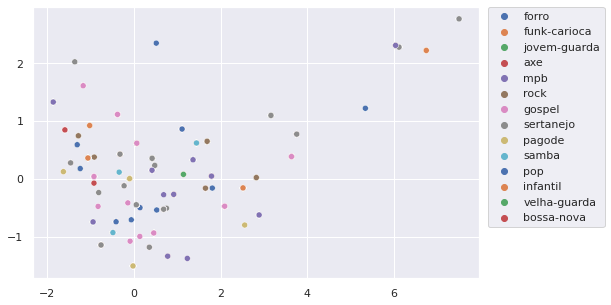

In [ ]:
%matplotlib inline
draw_scatter_plot(embeddings_train_title_lyrics_pca_shuffle_false, df_train['genre'])

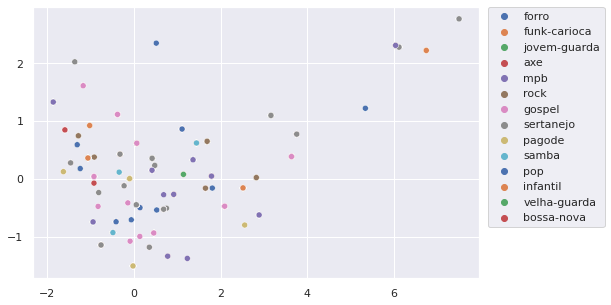

In [ ]:
%matplotlib inline
draw_scatter_plot(embeddings_train_title_lyrics_pca_shuffle_false, df_train['genre'])

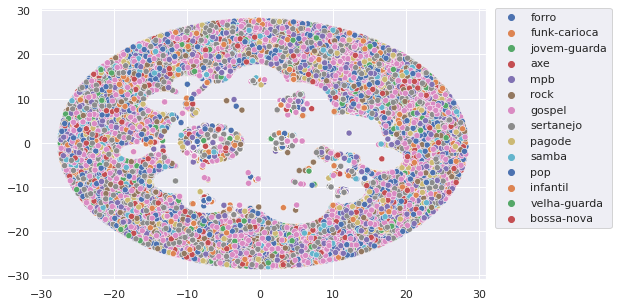

In [ ]:
%matplotlib inline
draw_scatter_plot(tsne_embeddings_train_lyrics_full_shuffle_false.embedding_, df_train['genre'])

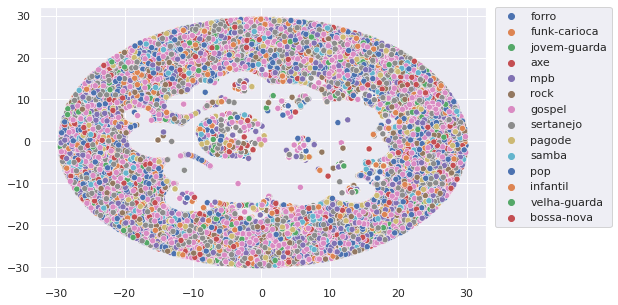

In [ ]:
%matplotlib inline
draw_scatter_plot(tsne_embeddings_train_lyrics_shuffle_false_perplexity50.embedding_, df_train['genre'])

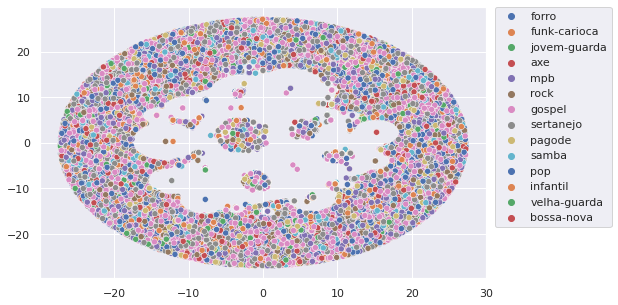

In [ ]:
%matplotlib inline
draw_scatter_plot(tsne_embeddings_train_lyrics_shuffle_false_perplexity10.embedding_, df_train['genre'])

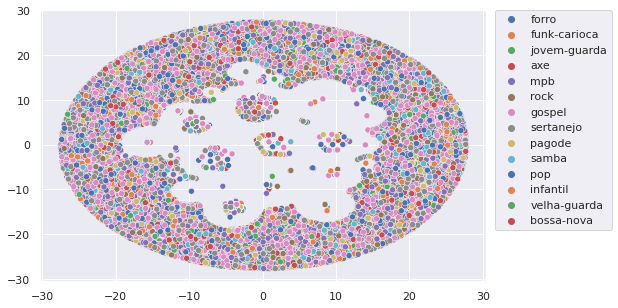

In [ ]:
%matplotlib inline
draw_scatter_plot(tsne_embeddings_train_title_shuffle_false_perplexity20.embedding_, df_train['genre'])

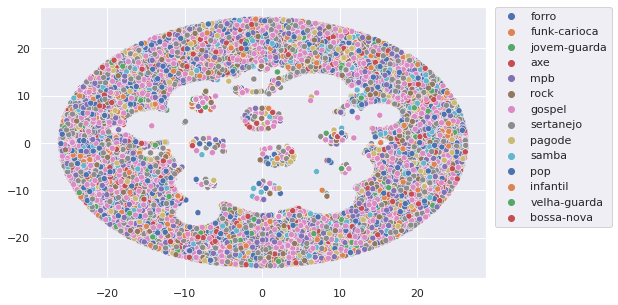

In [ ]:
%matplotlib inline
draw_scatter_plot(tsne_embeddings_train_title_shuffle_false_perplexity50.embedding_, df_train['genre'])

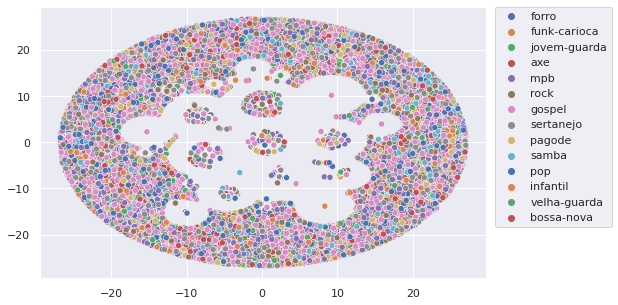

In [ ]:
%matplotlib inline
draw_scatter_plot(tsne_embeddings_train_title_shuffle_false_perplexity100.embedding_, df_train['genre'])

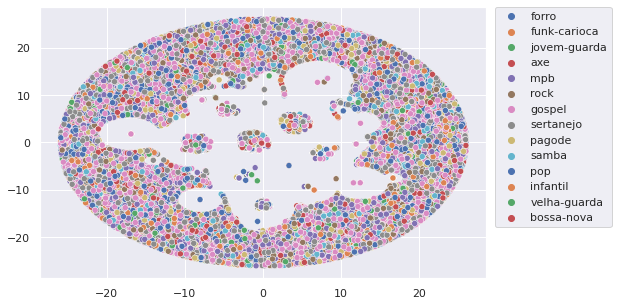

In [ ]:
%matplotlib inline
draw_scatter_plot(tsne_embeddings_train_title_shuffle_false_perplexity10.embedding_, df_train['genre'])

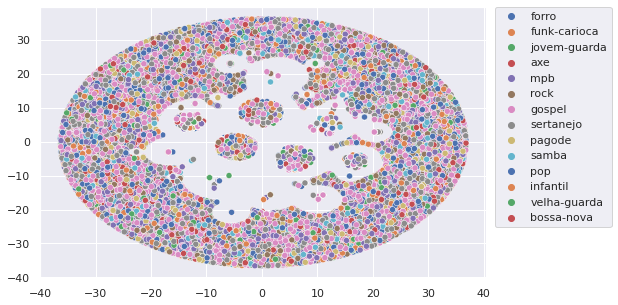

In [ ]:
%matplotlib inline
draw_scatter_plot(tsne_embeddings_train_title_shuffle_false_perplexity10_lr_100.embedding_, df_train['genre'])

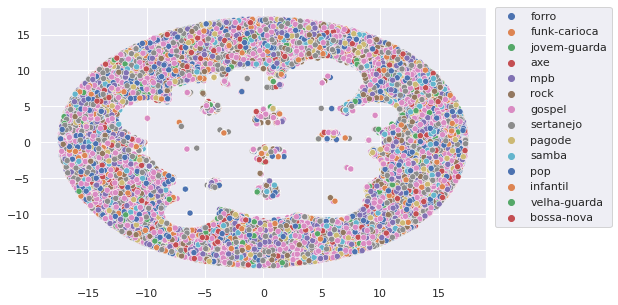

In [ ]:
%matplotlib inline
draw_scatter_plot(tsne_embeddings_train_title_shuffle_false_perplexity10_lr_20.embedding_, df_train['genre'])

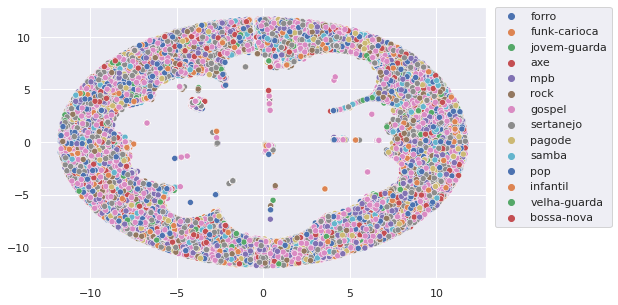

In [ ]:
%matplotlib inline
draw_scatter_plot(tsne_embeddings_train_title_shuffle_false_perplexity10_lr_10.embedding_, df_train['genre'])

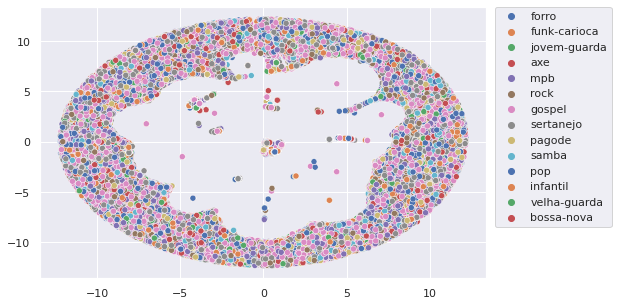

In [ ]:
%matplotlib inline
draw_scatter_plot(tsne_embeddings_train_title_shuffle_false_perplexity50_lr_10.embedding_, df_train['genre'])

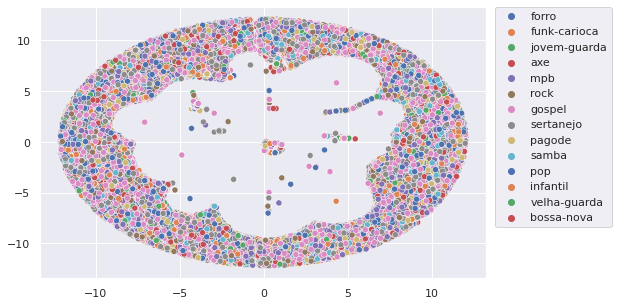

In [ ]:
%matplotlib inline
draw_scatter_plot(tsne_embeddings_train_title_shuffle_false_perplexity100_lr_10.embedding_, df_train['genre'])

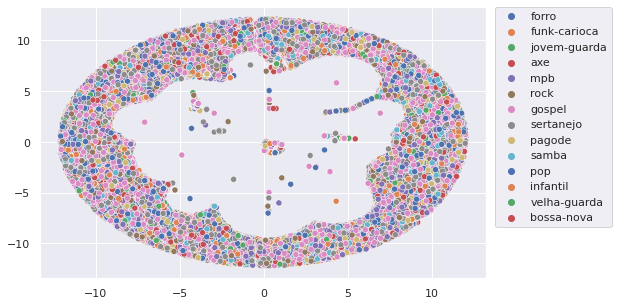

In [ ]:
%matplotlib inline
draw_scatter_plot(tsne_embeddings_train_title_lyrics_shuffle_false_perplexity100_lr_10.embedding_, df_train['genre'])

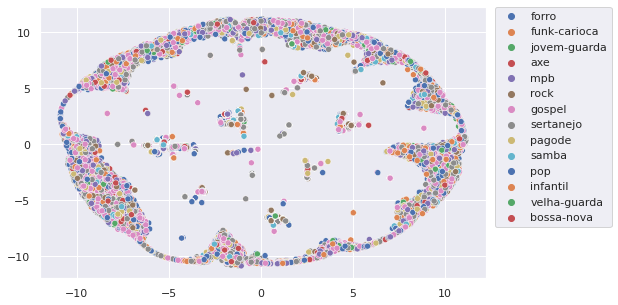

In [ ]:
%matplotlib inline
draw_scatter_plot(tsne_embeddings_train_title_lyrics_pca_shuffle_false30_perplexity100_lr_10.embedding_, df_train['genre'])

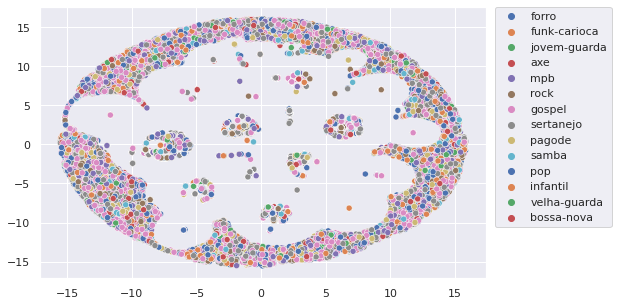

In [ ]:
%matplotlib inline
draw_scatter_plot(tsne_embeddings_train_title_lyrics_pca_shuffle_false30_perplexity100_lr_20.embedding_, df_train['genre'])

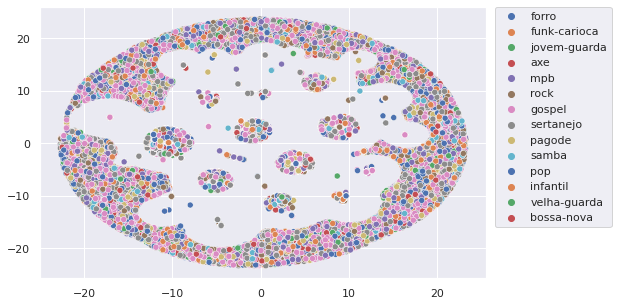

In [ ]:
%matplotlib inline
draw_scatter_plot(tsne_embeddings_train_title_lyrics_pca_shuffle_false30_perplexity100_lr_50.embedding_, df_train['genre'])

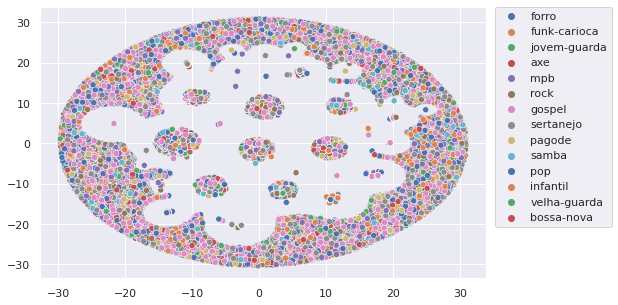

In [ ]:
%matplotlib inline
draw_scatter_plot(tsne_embeddings_train_title_lyrics_pca_shuffle_false30_perplexity100_lr_100.embedding_, df_train['genre'])

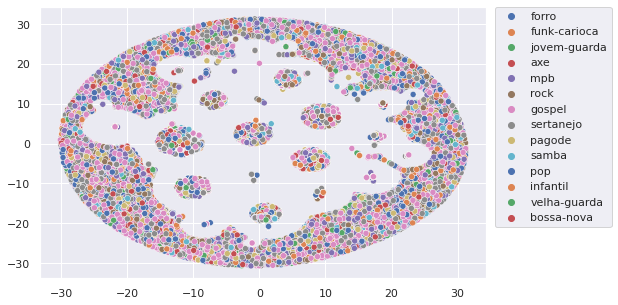

In [ ]:
%matplotlib inline
draw_scatter_plot(tsne_embeddings_train_title_lyrics_pca_shuffle_false30_perplexity50_lr_100.embedding_, df_train['genre'])

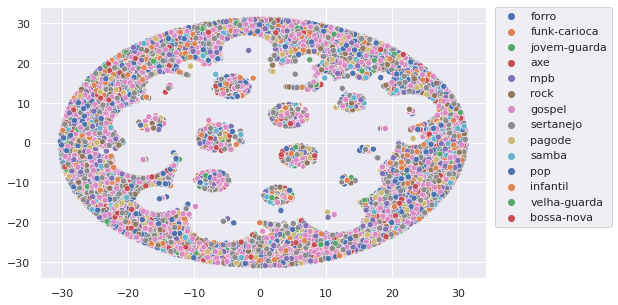

In [ ]:
%matplotlib inline
draw_scatter_plot(tsne_embeddings_train_title_lyrics_pca_shuffle_false30_perplexity20_lr_100.embedding_, df_train['genre'])

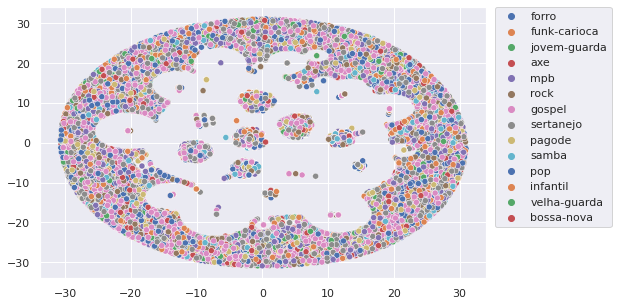

In [ ]:
%matplotlib inline
draw_scatter_plot(tsne_embeddings_train_title_lyrics_pca_shuffle_false30_perplexity10_lr_100.embedding_, df_train['genre'])

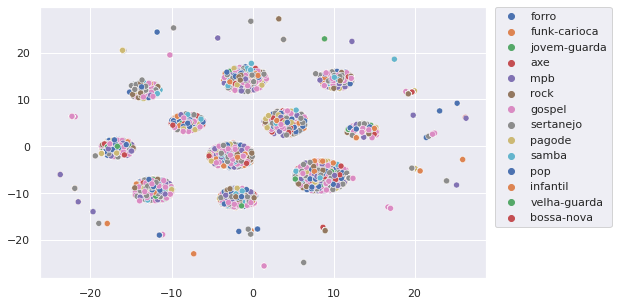

In [ ]:
%matplotlib inline
draw_scatter_plot(tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity10_lr_100.embedding_, df_train['genre'])

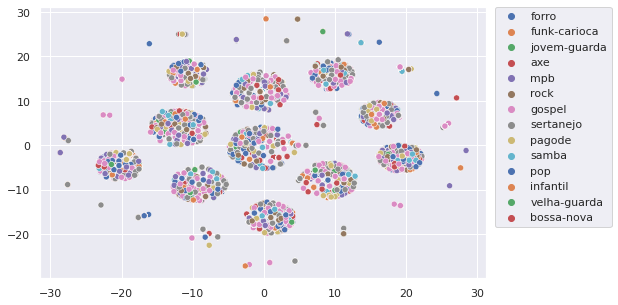

In [ ]:
%matplotlib inline
draw_scatter_plot(tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity20_lr_100.embedding_, df_train['genre'])

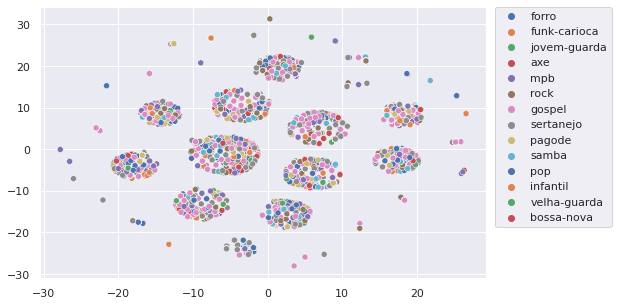

In [ ]:
%matplotlib inline
draw_scatter_plot(tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity30_lr_100.embedding_, df_train['genre'])

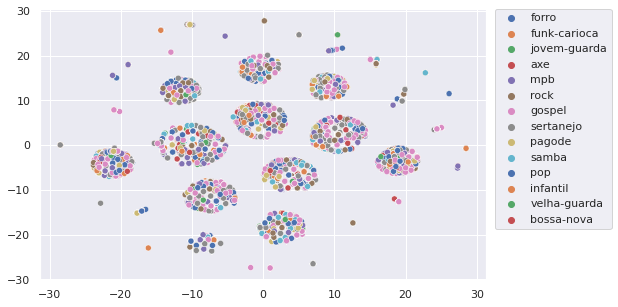

In [ ]:
%matplotlib inline
draw_scatter_plot(tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity40_lr_100.embedding_, df_train['genre'])

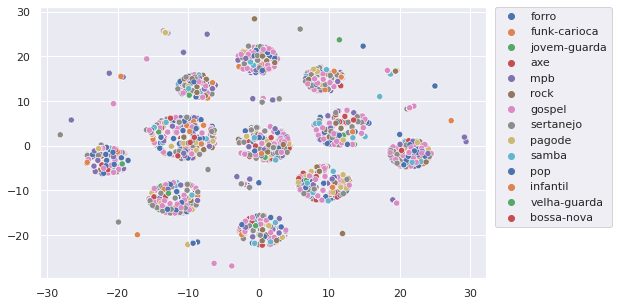

In [ ]:
%matplotlib inline
draw_scatter_plot(tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity50_lr_100.embedding_, df_train['genre'])

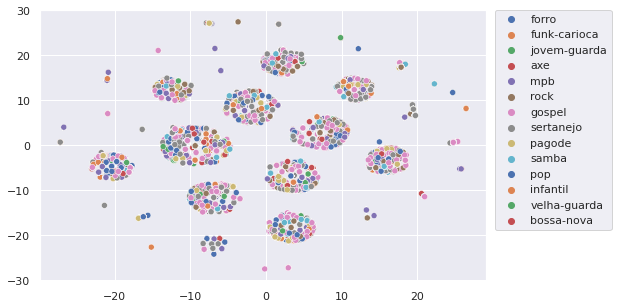

In [ ]:
%matplotlib inline
draw_scatter_plot(tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity60_lr_100.embedding_, df_train['genre'])

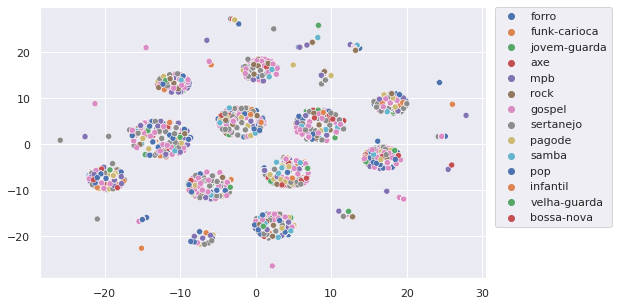

In [ ]:
%matplotlib inline
draw_scatter_plot(tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity100_lr_100.embedding_, df_train['genre'])

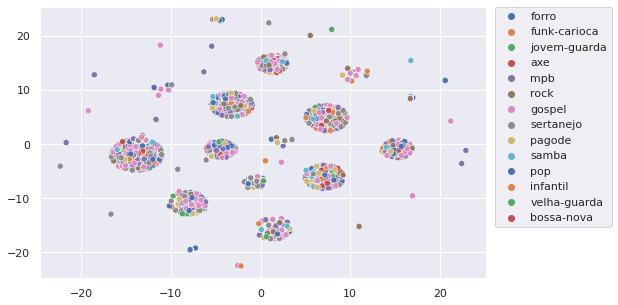

In [ ]:
%matplotlib inline
draw_scatter_plot(tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity100_lr_50.embedding_, df_train['genre'])

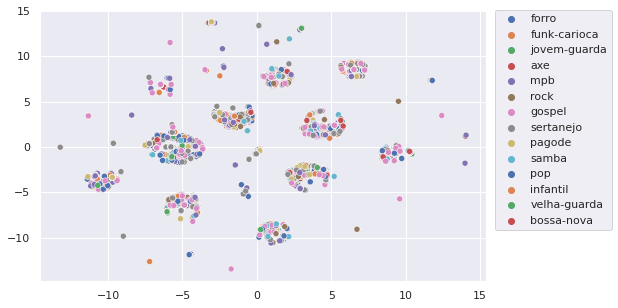

In [ ]:
%matplotlib inline
draw_scatter_plot(tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity100_lr_20.embedding_, df_train['genre'])

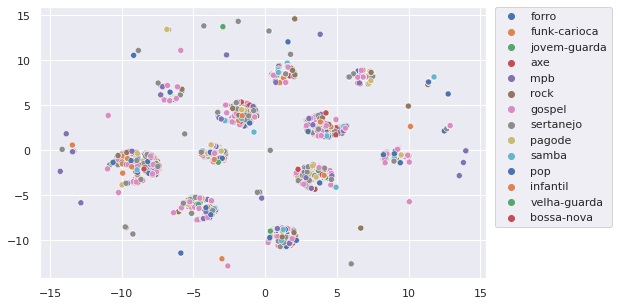

In [ ]:
%matplotlib inline
draw_scatter_plot(tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity5_lr_20.embedding_, df_train['genre'])

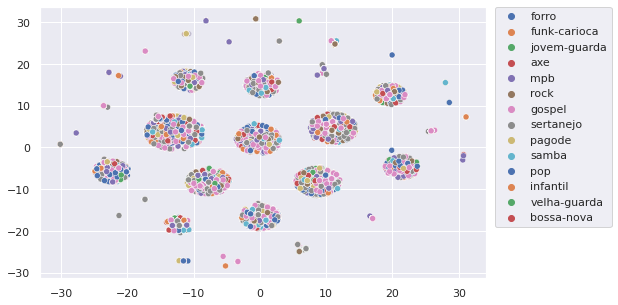

In [ ]:
%matplotlib inline
draw_scatter_plot(tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity50_lr_150.embedding_, df_train['genre'])

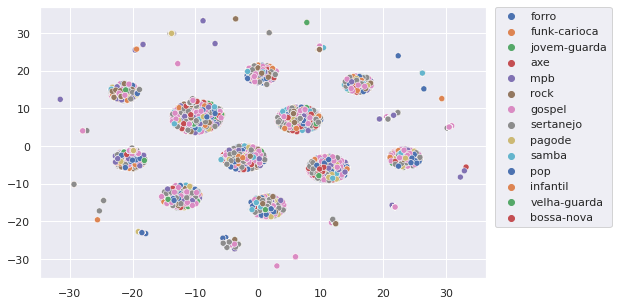

In [ ]:
%matplotlib inline
draw_scatter_plot(tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity50_lr_200.embedding_, df_train['genre'])

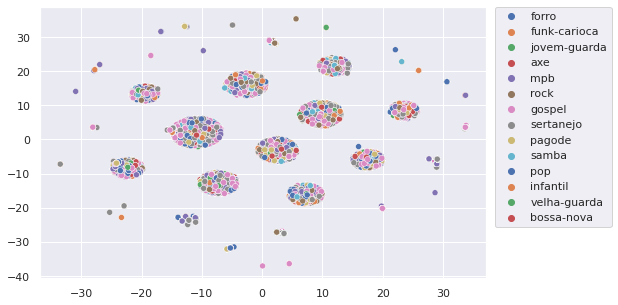

In [ ]:
%matplotlib inline
draw_scatter_plot(tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity50_lr_250.embedding_, df_train['genre'])

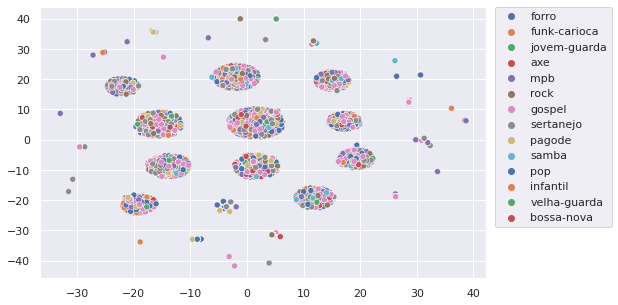

In [ ]:
%matplotlib inline
draw_scatter_plot(tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity50_lr_300.embedding_, df_train['genre'])

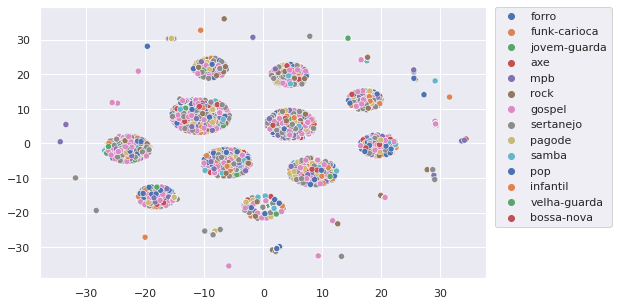

In [ ]:
%matplotlib inline
draw_scatter_plot(tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity30_lr_200.embedding_, df_train['genre'])

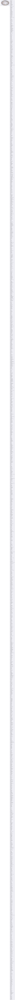

In [ ]:
%matplotlib inline
draw_scatter_plot(tsne_embeddings_train_lyrics_full_shuffle_false.embedding_, df_train['artist_name'])

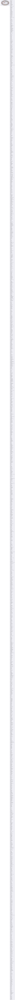

In [ ]:
%matplotlib inline
draw_scatter_plot(tsne_embeddings_train_lyrics_shuffle_false_perplexity50.embedding_, df_train['artist_name'])

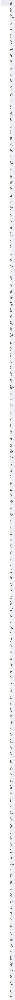

In [ ]:
%matplotlib inline
draw_scatter_plot(embeddings_train_title_pca_shuffle_false, df_train['artist_name'])

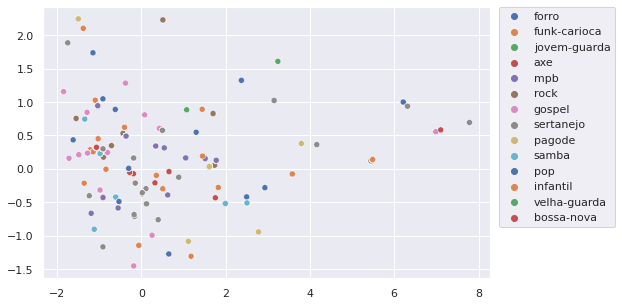

In [ ]:
%matplotlib inline
draw_scatter_plot(embeddings_train_lyrics_pca_shuffle_false, df_train['genre'])

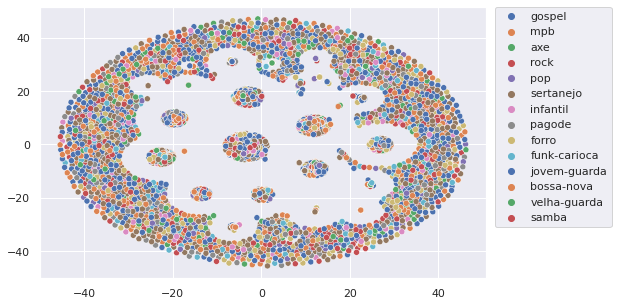

In [ ]:
%matplotlib inline
draw_scatter_plot(tsne_embeddings_dev_lyrics_shuffle_false.embedding_, df_dev['genre'])

#### Comparison between T-SNEs using Kullback-Leibler divergence

In [ ]:
tsnes_list = [
    (tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity10_lr_100,"tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity10_lr_100"),
    (tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity100_lr_100,"tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity100_lr_100"),
    (tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity100_lr_20,"tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity100_lr_20"),
    (tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity100_lr_50,"tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity100_lr_50"),
    (tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity20_lr_100,"tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity20_lr_100"),
    (tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity30_lr_100,"tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity30_lr_100"),
    (tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity30_lr_200,"tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity30_lr_200"),
    (tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity40_lr_100,"tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity40_lr_100"),
    (tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity5_lr_20,"tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity5_lr_20"),
    (tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity50_lr_100,"tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity50_lr_100"),
    (tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity50_lr_150,"tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity50_lr_150"),
    (tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity50_lr_200,"tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity50_lr_200"),
    (tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity50_lr_250,"tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity50_lr_250"),
    (tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity50_lr_300,"tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity50_lr_300"),
    (tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity60_lr_100,"tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity60_lr_100"),
]

In [ ]:
best_tsne, best_tsne_name = min(tsnes_list, key= lambda k: k[0].kl_divergence_)

In [ ]:
best_tsne, best_tsne.embedding_.shape, best_tsne_name, best_tsne.kl_divergence_

(TSNE(init='random', learning_rate=100.0, n_jobs=-1, perplexity=100,
      random_state=0, verbose=1),
 (96783, 2),
 'tsne_embeddings_train_title_lyrics_pca_shuffle_false15_perplexity100_lr_100',
 2.0596442222595215)

In [ ]:
best_tsne_model_file_name = "best_tsne.pickle"
save_tsne_embeddings(best_tsne, best_tsne_model_file_name)

saving: best_tsne.pickle
saved: best_tsne.pickle


In [ ]:
best_tsne_loaded = load_tsne_embeddings(best_tsne_model_file_name)

loading: best_tsne.pickle
loaded: best_tsne.pickle


In [ ]:
best_tsne_loaded, best_tsne_loaded.embedding_.shape, best_tsne_loaded.kl_divergence_

(TSNE(init='random', learning_rate=100.0, n_jobs=-1, perplexity=100,
      random_state=0, verbose=1),
 (96783, 2),
 2.0596442222595215)

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


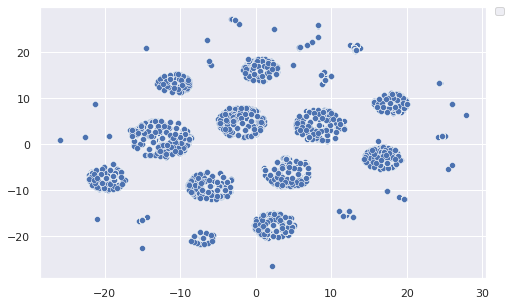

In [ ]:
%matplotlib inline
draw_scatter_plot(best_tsne.embedding_)


What are the conclusions? (1-2 paragraphs)




For the chosen embedding, which was *Title + music* embedding, we explored and plotted different types of dimensionality reduction extensively. We started by using the PCA method with only 2 components, but we could verify that it retains very little of the original variance (about 58%). Moreover, when looking at the distribution of the data, we were unable to gain any insight about possible clusters.
For the t-SNE method, we found that it apparently doesn't scale very well for a large number of features, and although we were able to run it using the training dataset considering all 768 features for each datapoint, it's not possible to visualize anything useful when we plot the scatter. At the end, the model that gave us the most intuitive visualization of the data was a combination of a PCA with 15 components (which preserves more than 96% of the original variance) plus a t-SNE. The PCA output was used as input for the t-SNE. Also, we tested several approaches for the t-SNE, varying its hyperparameters, and finally chose the one who provided the lowest value for the Kullback-Leibler divergence (a very nice idea of this concept can be found in this [video](https://www.youtube.com/watch?v=SxGYPqCgJWM)).

In summary, the dimensionality reduction that brought the best visualization was the reduction to 15 dimensions via PCA allied to a t-SNE with *perplexity = 100* and *learning_rate = 100*.
As you can see, the visualization we mentioned, which is the blue one plotted above, indicates the existence of at least 12 clusters. However, with the help of subtitles, we could see that the grouping was not made by musical genre neither artist. It seems that the similarity shown was based on some other parameter, which we don't know so far.

### 2. Use a clustering algorithm to identify the possible groups present in the data set and to choose the size of k use the Elbow curve method. Also analyze the influence of the distance used in the chosen algorithm. Plot the generated groups using the information learned by the model.

As clustering algorithm to be used for training, we chose K-means (an intuitive notion of this method, which we used as source of understanding, can be consulted in this [lecture](https://www.youtube.com/watch?v=hDmNF9JG3lo) by Andrew Ng, from Stanford University). For our case, actually, we'll use the *MiniBatchKMeans* model, so that the training performance might be faster, using batches of size 256.

The number *k* must be passed as a parameter tough. A brief idea of ​​choosing the ideal *k* is given in the diagram below.

![picture](https://drive.google.com/uc?id=1UOLLDBlBXsevzIsRyYExS282tIyMa691)

In a few words, the idea is to initialize with k = 1 and vary it up to a reasonable number of clusters. For each k, the sum of the differences from each datapoint to its respective centroid is calculated. Obviously, for k = N, where N is the size of the dataset, we'll get 0 for this difference, but that's not the purpose. We want to use an adequate number of clusters such that increasing this number does not significantly improve the value of the difference between datapoints and centroids. 

By that we can already see that the k-means is very sensitive to the distance between the points, by its own definition.

In [ ]:
from sklearn.cluster import MiniBatchKMeans
from sklearn.metrics import silhouette_score

class Clustering():
    #Define parameters
    def __init__(self, k_param, n_cores=10):
        #replace for Clustering 
        self.cluster = MiniBatchKMeans(
            n_clusters=k_param, 
            random_state=0, 
            batch_size=256*n_cores #paralellize batches in 6 cores
        )
        self.k = k_param
    
    def fit(self, X):
        return self.cluster.fit(X)
    
    def predict(self, X):
        return self.cluster.predict(X)

    def save_model(self, filename):
        """
        Save the model to disk
        """
        pickle.dump(self.cluster, open(folder + filename, 'wb'))
    
    def load_model(self, filename):
        self.cluster = pickle.load(open(folder + filename, 'rb'))

    @property
    def centers(self):
        return self.cluster.cluster_centers_

    @property
    def labels(self):
        return self.cluster.labels_

    @property
    def score(self):
        return self.cluster.inertia_

To choose the appropriate number of clusters, we used the Elbow Method, which consists of plotting the curve of the sum of the difference between the datapoints and their respective centroids (y-axis) by the number k of clusters in each case (x-axis). Hence, when looking at the graph, we must identify which point would correspond to the "elbow" of the curve, and this point will be defined as the optimal number of clusters. However, that is not a golden value and its determination can be somewhat subjective. We'll use as an approach an intuitive idea that consists of drawing a line between k = 1 to the last k of the curve, and then selecting the point with the greatest distance to this line.

#### Function to plot the elbow curve and store the computed clustering models

In [ ]:
from tqdm import tqdm
def compute_elbow_for_clustering(max_k, dataset):
    print (f"elbow computing started: ", time.strftime("%H:%M:%S"))
    start = time.time()
    
    inertia_list = []
    models_k_dict = dict()
    for k in tqdm(range(1, max_k + 1)):
        cluster_model = Clustering(k)
        cluster_model.fit(dataset)
        models_k_dict[k] = cluster_model
        inertia_list.append(cluster_model.score)

    fig, ax = plt.subplots()
    ax.set_xticks(range(1,max_k + 1))
    plt.plot(range(1, max_k + 1), inertia_list, 'o-r')
    plt.grid(True)
    plt.title('Elbow curve')
    
    end = time.time()
    print(f"seconds {end - start} / minutes {(end - start)/60}")
    print (f"elbow computing ended: ", time.strftime("%H:%M:%S"))
    return models_k_dict, inertia_list

#### Function to choose the best k for the computed elbow curve
The function draws a line between the inertia for k = 1 and the last computed k, and then it chooses the k which is farest from the curve as an empirical intuition that it might be a fair choice for a point in the tip of the elbow.

In [ ]:
def choose_best_k(inertia_list, k_start, k_end):
    x1, y1 = k_start, inertia_list[0]
    x2, y2 = k_end, inertia_list[-1]

    distances = []
    for x, y in enumerate(tqdm(inertia_list)):
        x0 = x + k_start
        y0 = y
        numerator = abs((y2-y1)*x0 - (x2-x1)*y0 + x2*y1 - y2*x1)
        denominator = sqrt((y2 - y1)**2 + (x2 - x1)**2)
        distances.append(numerator/denominator)

    return distances.index(max(distances)) + k_start

elbow computing started:  04:44:40


100%|███████████████████████████████████████████████████████████████████████████████████| 20/20 [00:01<00:00, 14.47it/s]


seconds 1.4067869186401367 / minutes 0.02344644864400228
elbow computing ended:  04:44:41


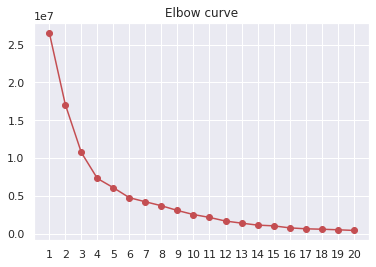

In [ ]:
cluster_models_k_20, inertia_list_k_20 = compute_elbow_for_clustering(20, best_tsne.embedding_)

In [ ]:
best_k_for_tsne_when_kmax_20 = choose_best_k(inertia_list_k_20, 1, 20)
print(best_k_for_tsne_when_kmax_20)

100%|███████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 106861.25it/s]

4


elbow computing started:  04:45:05


100%|███████████████████████████████████████████████████████████████████████████████| 1000/1000 [13:35<00:00,  1.23it/s]


seconds 816.5029511451721 / minutes 13.608382519086202
elbow computing ended:  04:58:42


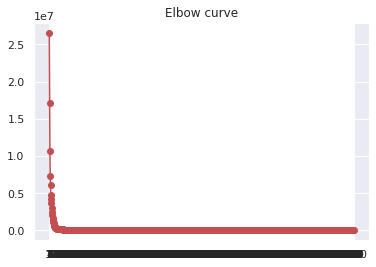

In [ ]:
cluster_models_k_1000, inertia_list_k_1000 = compute_elbow_for_clustering(1000, best_tsne.embedding_)

In [ ]:
best_k_for_tsne_when_kmax_1000 = choose_best_k(inertia_list_k_1000, 1, 1000)
print(best_k_for_tsne_when_kmax_1000)

100%|██████████████████████████████████████████████████████████████████████████| 1000/1000 [00:00<00:00, 1107553.21it/s]

23


elbow computing started:  04:58:50


100%|███████████████████████████████████████████████████████████████████████████████████| 20/20 [00:11<00:00,  1.80it/s]


seconds 11.254913806915283 / minutes 0.1875818967819214
elbow computing ended:  04:59:01


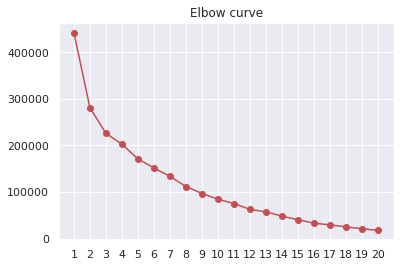

In [ ]:
cluster_models_original_embedding_k_20, inertia_list_original_embedding_k_20 = compute_elbow_for_clustering(20, embeddings_train_title_lyrics_shuffle_false)

In [ ]:
best_k_for_original_dataset_when_kmax_20 = choose_best_k(inertia_list_original_embedding_k_20, 1, 20)
print(best_k_for_original_dataset_when_kmax_20)

100%|███████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 177724.75it/s]

5


elbow computing started:  04:59:01


100%|█████████████████████████████████████████████████████████████████████████████| 1000/1000 [4:00:13<00:00, 14.41s/it]


seconds 14414.164272546768 / minutes 240.2360712091128
elbow computing ended:  08:59:15


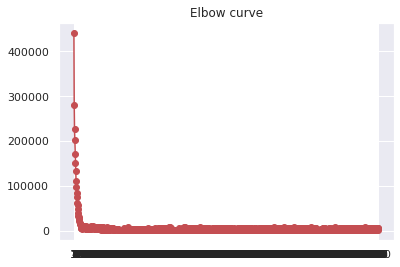

In [ ]:
cluster_models_original_embedding_k_1000, inertia_list_original_embedding_k_1000 = compute_elbow_for_clustering(1000, embeddings_train_title_lyrics_shuffle_false)

In [ ]:
best_k_for_original_dataset_when_kmax_1000 = choose_best_k(inertia_list_original_embedding_k_1000, 1, 1000)
print(best_k_for_original_dataset_when_kmax_1000)

100%|██████████████████████████████████████████████████████████████████████████| 1000/1000 [00:00<00:00, 1094261.41it/s]

25


In [ ]:
clustering_original_dataset_when_kmax_1000 = cluster_models_original_embedding_k_1000[best_k_for_original_dataset_when_kmax_1000]
clustering_original_dataset_when_kmax_1000

In [ ]:
clustering_original_dataset_when_kmax_1000_file_name = "clustering_original_dataset_when_kmax_1000.pickle"

In [ ]:
clustering_original_dataset_when_kmax_1000.save_model(clustering_original_dataset_when_kmax_1000_file_name)

In [ ]:
clustering_original_dataset_when_kmax_1000_loaded = Clustering(None)
clustering_original_dataset_when_kmax_1000_loaded.load_model(clustering_original_dataset_when_kmax_1000_file_name)

In [ ]:
clustering_original_dataset_when_kmax_1000.centers.shape

(25, 768)

In [ ]:
clustering_original_dataset_when_kmax_1000.labels.shape

(96783,)

In [ ]:
embeddings_train_title_lyrics_shuffle_false.shape

(96783, 768)

In [ ]:
silhouette_avg_clustering_original_dataset_when_kmax_1000 = silhouette_score(
    embeddings_train_title_lyrics_shuffle_false, 
    clustering_original_dataset_when_kmax_1000.labels
)

In [ ]:
silhouette_avg_clustering_original_dataset_when_kmax_1000

0.9792041

In [ ]:
clustering_tsne_when_kmax_1000 = cluster_models_k_1000[best_k_for_tsne_when_kmax_1000]
clustering_tsne_when_kmax_1000

In [ ]:
clustering_tsne_when_kmax_1000_file_name = "clustering_tsne_when_kmax_1000.pickle"

In [ ]:
clustering_tsne_when_kmax_1000.save_model(clustering_tsne_when_kmax_1000_file_name)

In [ ]:
clustering_tsne_when_kmax_1000_loaded = Clustering(None)
clustering_tsne_when_kmax_1000_loaded.load_model(clustering_tsne_when_kmax_1000_file_name)

In [ ]:
clustering_tsne_when_kmax_1000.centers.shape

(23, 2)

In [ ]:
clustering_tsne_when_kmax_1000.labels.shape

(96783,)

In [ ]:
best_tsne.embedding_.shape

(96783, 2)

In [ ]:
silhouette_avg_clustering_tsne_when_kmax_1000 = silhouette_score(
    best_tsne.embedding_, 
    clustering_tsne_when_kmax_1000.labels
)
silhouette_avg_clustering_tsne_when_kmax_1000

0.7941359


What are the conclusions? (1-2 paragraphs)




We trained k-means with different numbers of k. We also tested the two different types of embeddings: the original with 768 features and the one with reduced dimensionality via PCA plus t-SNE. For both types of embeddings, we used the Elbow Method to determine the "optimal" value of k, and the values ​​obtained were very close to each other. When k was set to a maximum value of 20, we obtained 5 and 4 for k using the original embedding and the embedding via t-SNE, respectively; and when k was set to a maximum value of 1000, we obtained 25 and 23 for k using the original embedding and the embedding via t-SNE, respectively. It suggests that the dimensionality reduction via custom t-SNE with PCA brings a good representation of the original dataset, as we imagined before.

In order to validate the value of k obtained with the Elbow method, we computed the *Silhouette Coefficient* (a good reference in Portuguese that shows a practical example of using the method can be consulted [here](https://www.youtube.com/watch?v=VP7kEUuswgg)) and obtained values ​​of 0.97 and 0.79 for the original and via t-SNE reduction embeddings, respectively, which are considered very good by the method.

### 3. Use the test data to make a qualitative assessment of the model by comparing whether new data are clustered that have a certain similarity. Analyze the models generated through the Silhouete calculation and discuss the generated results.

#### Running silhouete score through test dataset using the full clustering model (using 768 features)

In [ ]:
test_full_predicted_labels = clustering_original_dataset_when_kmax_1000_loaded.predict(embeddings_test_title_lyrics_shuffle_false)

In [ ]:
embeddings_test_title_lyrics_shuffle_false.shape

(27654, 768)

In [ ]:
test_full_predicted_labels.shape

(27654,)

In [ ]:
silhouette_avg_test_full_predicted_labels = silhouette_score(
    embeddings_test_title_lyrics_shuffle_false, 
    test_full_predicted_labels
)
silhouette_avg_test_full_predicted_labels

0.97974986

#### Running silhouete score to test dataset using the t-sne clustering model (using 2 components)

In [ ]:
pca_test_title_lyrics_shuffle_false15 = PCA(n_components=15, random_state=0)
pca_test_title_lyrics_shuffle_false15.fit(embeddings_test_title_lyrics_shuffle_false)
embeddings_test_title_lyrics_pca_shuffle_false15 = pca_test_title_lyrics_shuffle_false15.transform(embeddings_test_title_lyrics_shuffle_false)
print(embeddings_test_title_lyrics_pca_shuffle_false15.shape)
print(sum(pca_test_title_lyrics_shuffle_false15.explained_variance_ratio_), pca_test_title_lyrics_shuffle_false15.explained_variance_ratio_)

(27654, 15)
0.9632062148302794 [0.46903676 0.11455086 0.0802857  0.05833911 0.04578969 0.04018584
 0.03351189 0.02861384 0.02654463 0.01752186 0.01244955 0.01116698
 0.00907089 0.00824529 0.00789333]


In [ ]:
tsne_embeddings_test_title_lyrics_pca_shuffle_false15_perplexity30_lr_200 = compute_tsne(
    embedding=embeddings_test_title_lyrics_pca_shuffle_false15, 
    n_components=2, 
    perplexity=100,
    learning_rate=100.0
)

TSNE started:  19:53:37
[t-SNE] Computing 301 nearest neighbors...
[t-SNE] Indexed 27654 samples in 0.035s...
[t-SNE] Computed neighbors for 27654 samples in 1.686s...
[t-SNE] Computed conditional probabilities for sample 1000 / 27654
[t-SNE] Computed conditional probabilities for sample 2000 / 27654
[t-SNE] Computed conditional probabilities for sample 3000 / 27654
[t-SNE] Computed conditional probabilities for sample 4000 / 27654
[t-SNE] Computed conditional probabilities for sample 5000 / 27654
[t-SNE] Computed conditional probabilities for sample 6000 / 27654
[t-SNE] Computed conditional probabilities for sample 7000 / 27654
[t-SNE] Computed conditional probabilities for sample 8000 / 27654
[t-SNE] Computed conditional probabilities for sample 9000 / 27654
[t-SNE] Computed conditional probabilities for sample 10000 / 27654
[t-SNE] Computed conditional probabilities for sample 11000 / 27654
[t-SNE] Computed conditional probabilities for sample 12000 / 27654
[t-SNE] Computed conditio

In [ ]:
tsne_embeddings_test_title_lyrics_pca_shuffle_false15_perplexity30_lr_200_file_name = "tsne_embeddings_test_title_lyrics_pca_shuffle_false15_perplexity30_lr_200.pickle"

In [ ]:
save_tsne_embeddings(
    tsne_embeddings_test_title_lyrics_pca_shuffle_false15_perplexity30_lr_200, 
    tsne_embeddings_test_title_lyrics_pca_shuffle_false15_perplexity30_lr_200_file_name
)

In [ ]:
tsne_embeddings_test_title_lyrics_pca_shuffle_false15_perplexity30_lr_200_loaded = load_tsne_embeddings(
    tsne_embeddings_test_title_lyrics_pca_shuffle_false15_perplexity30_lr_200_file_name
)

loading: tsne_embeddings_test_title_lyrics_pca_shuffle_false15_perplexity30_lr_200.pickle
loaded: tsne_embeddings_test_title_lyrics_pca_shuffle_false15_perplexity30_lr_200.pickle


In [ ]:
tsne_embeddings_test_title_lyrics_pca_shuffle_false15_perplexity30_lr_200.embedding_.shape

(27654, 2)

In [ ]:
tsne_embeddings_test_title_lyrics_pca_shuffle_false15_perplexity30_lr_200_loaded.embedding_.shape

(27654, 2)

In [ ]:
df_test['genre'].shape

(27654,)

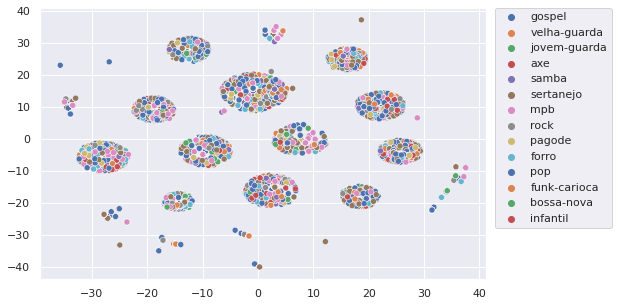

In [ ]:
draw_scatter_plot(
    tsne_embeddings_test_title_lyrics_pca_shuffle_false15_perplexity30_lr_200_loaded.embedding_,
    df_test['genre']
)

In [ ]:
test_tsne_predicted_labels = clustering_tsne_when_kmax_1000_loaded.predict(tsne_embeddings_test_title_lyrics_pca_shuffle_false15_perplexity30_lr_200_loaded.embedding_)

In [ ]:
test_tsne_predicted_labels.shape

(27654,)

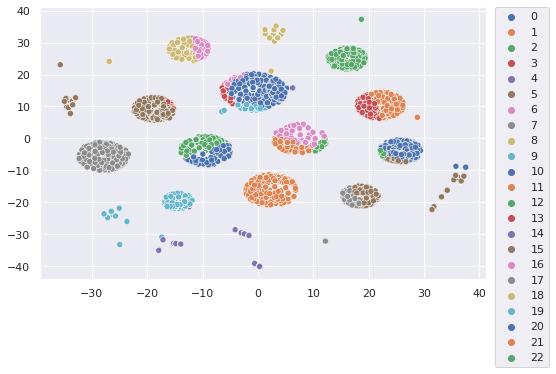

In [ ]:
draw_scatter_plot(
    tsne_embeddings_test_title_lyrics_pca_shuffle_false15_perplexity30_lr_200_loaded.embedding_,
    test_tsne_predicted_labels
)

In [ ]:
silhouette_avg_test_tsne_predicted_labels = silhouette_score(
    tsne_embeddings_test_title_lyrics_pca_shuffle_false15_perplexity30_lr_200_loaded.embedding_, 
    test_tsne_predicted_labels
)
silhouette_avg_test_tsne_predicted_labels

0.45907947


What are the conclusions? (1-2 paragraphs)




Using the original embedding in the test set, and using the k = 25 obtained in the previous question, we obtained a value of 0.98 for the Silhouette Coefficient in the test dataset, which can be considered an excellent result per si, but it would be more useful to plot the silhouete graphs to compare clusters and check their parameters. When we use the embedding via t-SNE, however, this value drops to 0.46, which suggests that in this case the dimensionality reduction did not perform as well as we would like. Nonetheless, as we did not change anything in the parameters in relation to the model adopted for the training set, perhaps the explanation may be there. Anyway, as it was computationally feasible to run k-means in the original embedding, we can be satisfied.

Looking at the scatter plots originated, as we already imagined, we could see that the groupings consider some other type of similarity that is not necessarily the musical genre (some association between the words contained in the lyrics of the songs, for example). When we look at the scatter plot with the t-SNE 2D with the subtitles of musical genres, we realize that they are actually quite mixed together. However, the visual configuration, which maintains, as in question 1, at least 12 clusters, suggests that perhaps another type of clustering method, combined with other types of embeddings and data processing, may be more successful. Something that, of course, should be dealt with in greater depth than what we were able to address in this project.

## Submission

On Google Classroom, submit your Jupyter Notebook (in Portuguese or English).

**This activity is NOT individual, it must be done in pairs (two-person group).**